<a href="https://colab.research.google.com/github/RVasconcelosMiguel/ComputerVision/blob/main/Project_1_VCOMP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<h1> <b>Computer Vision 2024/2025 (1<sup>st</sup> semester) </b> </h1>
<p>Master in Electrical and Computer Engineering </p>

</Body>  


FEUP, 2024



# **Project #01**

# **Identification**

* **Name:** Bernardo de Almeida Soeiro
* **Student Number:** 202008204

* **Name:** Tomás Rosa Carreira
* **Student Number:** 202007783

* **Name:** Rodrigo de Vasconcelos e Miguel
* **Student Number:** 202008406

#Loading and Organizing Image Files for Calibration and Data Processing

In [ ]:
from google.colab import drive
import shutil
import os

# Montar Google Drive
drive.mount('/content/drive')

# Caminho para a pasta no Google Drive onde os arquivos estão
extracted_files_path = '/content/drive/MyDrive/Colab Notebooks/VCOMP/Data'

# Copiar a árvore de diretórios da pasta para o diretório atual do Colab
shutil.copytree(extracted_files_path, '/content/CV_Assignment', dirs_exist_ok=True)

print('A pasta CV_Assignment foi copiada para o diretório atual do Colab.')

# Importar a biblioteca Pillow
from PIL import Image

# Caminho para a pasta calib dentro de assign1 no diretório CV_Assignment
calib_path = "/content/CV_Assignment/assign1/calib"
data_path1 = "/content/CV_Assignment/assign1/data/white_isolated"
data_path2 = "/content/CV_Assignment/assign1/data/white_mix"
data_path3 = "/content/CV_Assignment/assign1/data/brown_mix"

# Armazenar todas as imagens PNG da pasta calib em um array
calib_images_array = [os.path.join(calib_path, filename) for filename in os.listdir(calib_path) if filename.endswith('.png')]
data_images_array = [os.path.join(data_path1, filename) for filename in os.listdir(data_path1) if filename.endswith('.png')]
data_images_array_mix= [os.path.join(data_path2, filename) for filename in os.listdir(data_path2) if filename.endswith('.png')]
data_images_array_brown= [os.path.join(data_path3, filename) for filename in os.listdir(data_path3) if filename.endswith('.png')]

# Exibir os caminhos das imagens carregadas
print(f'Imagens carregadas da pasta calib: {calib_images_array}')
print(f'Imagens carregadas da pasta data: {data_images_array}')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
A pasta CV_Assignment foi copiada para o diretório atual do Colab.
Imagens carregadas da pasta calib: ['/content/CV_Assignment/assign1/calib/calib_23.png', '/content/CV_Assignment/assign1/calib/calib_32.png', '/content/CV_Assignment/assign1/calib/calib_15.png', '/content/CV_Assignment/assign1/calib/calib_16.png', '/content/CV_Assignment/assign1/calib/calib_25.png', '/content/CV_Assignment/assign1/calib/calib_11.png', '/content/CV_Assignment/assign1/calib/calib_7.png', '/content/CV_Assignment/assign1/calib/calib_8.png', '/content/CV_Assignment/assign1/calib/calib_9.png', '/content/CV_Assignment/assign1/calib/calib_6.png', '/content/CV_Assignment/assign1/calib/calib_22.png', '/content/CV_Assignment/assign1/calib/calib_33.png', '/content/CV_Assignment/assign1/calib/calib_10.png', '/content/CV_Assignment/assign1/calib/calib_19.png', '/content/CV_Assignment/assign

# 1

## Calibration Setup


This code is designed to detect the corresponding corner points of chessboards across multiple images. It uses the real-world 3D points of the chessboard and the detected 2D points in the images to establish correspondences between them. This points will allows to discover the calibration parameters.

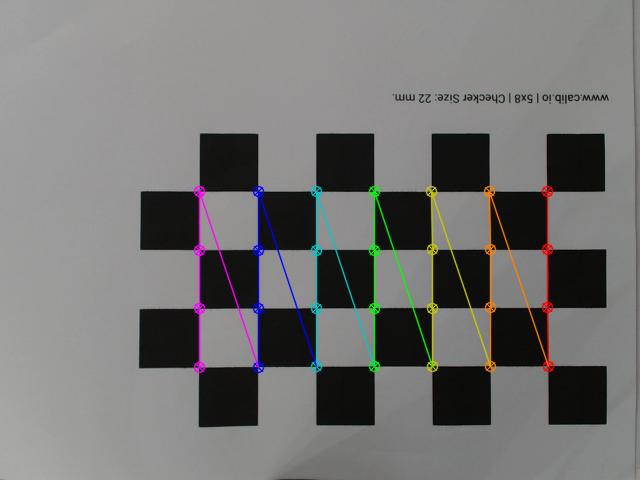

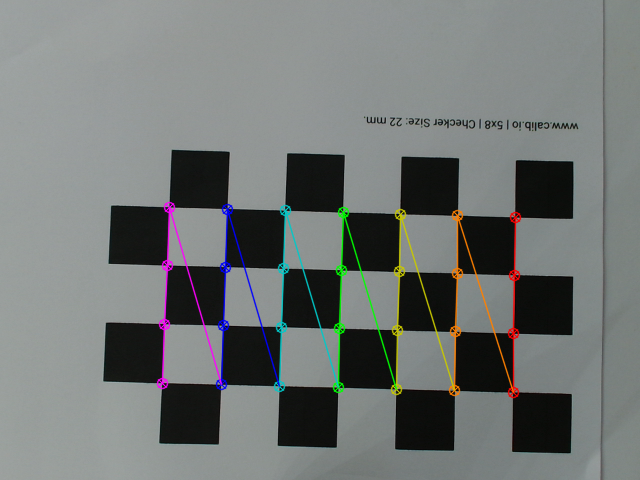

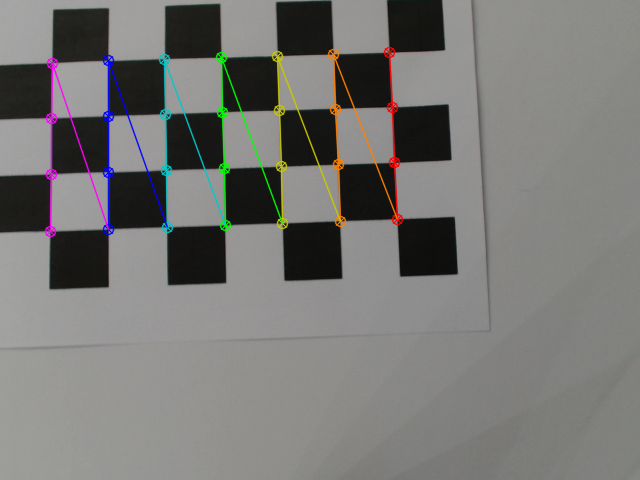

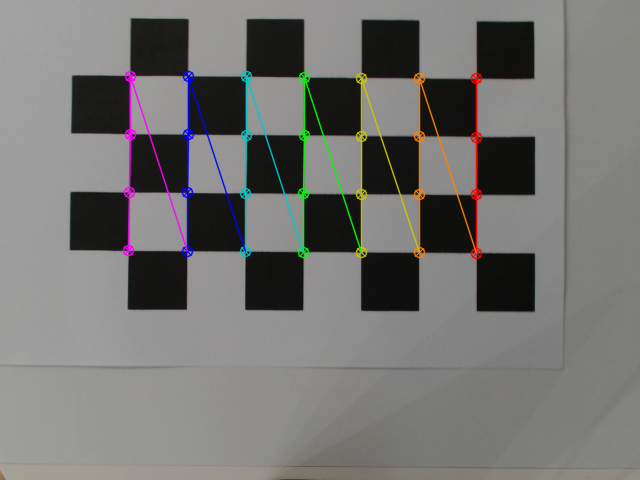

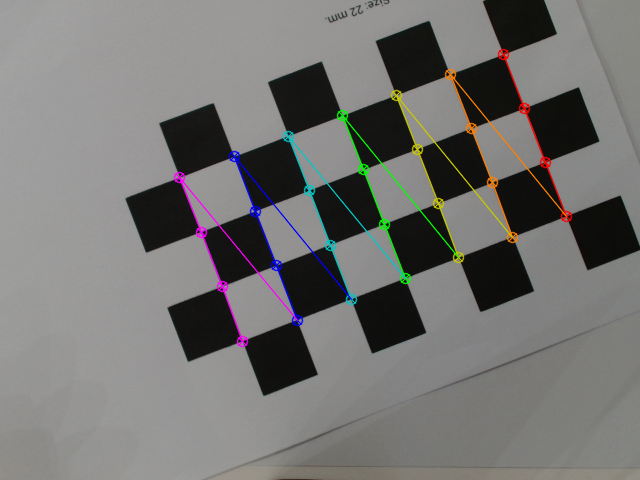

...

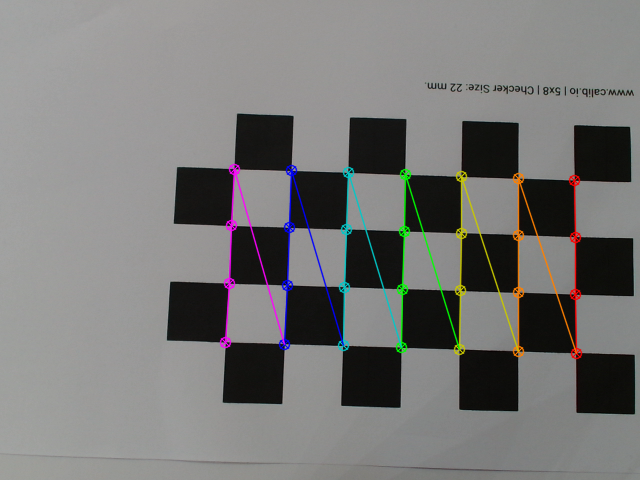

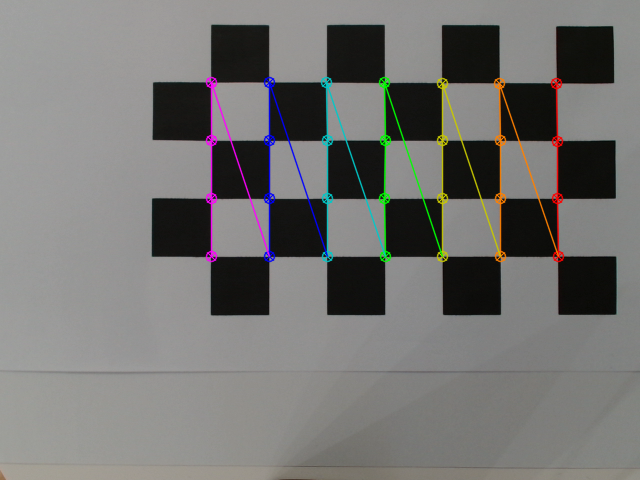

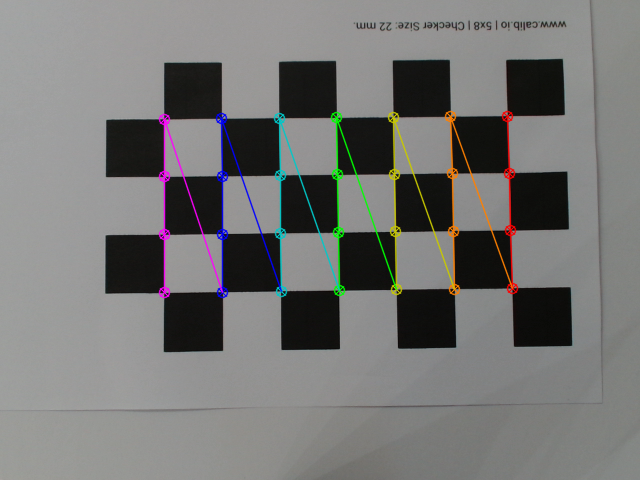

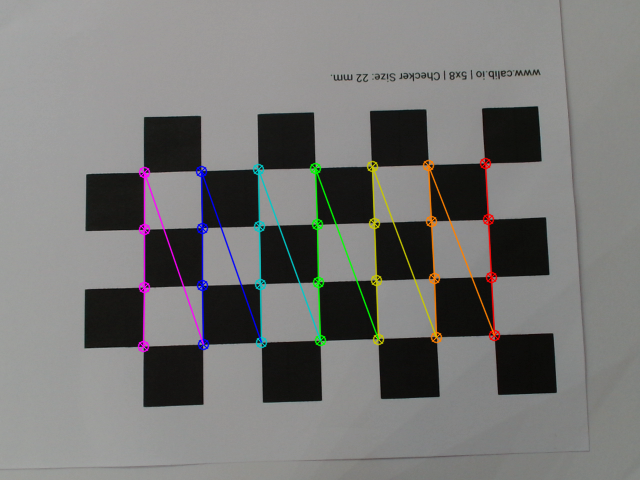

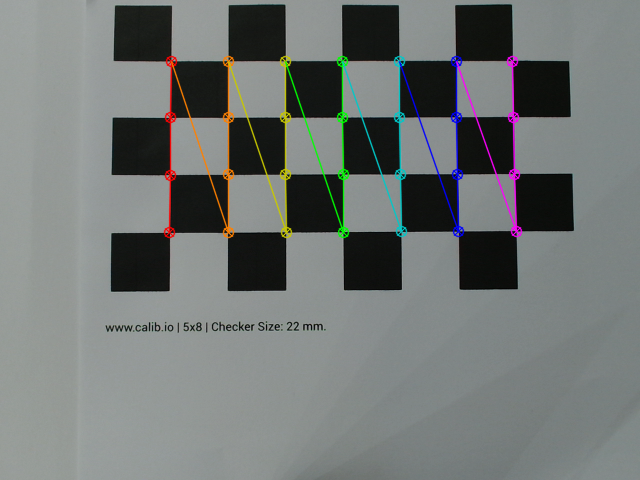

In [ ]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv_imshow

chessboardSize = (4,7)

# termination criteria
criteria = (cv.TERM_CRITERIA_EPS + cv.TERM_CRITERIA_MAX_ITER, 30, 0.001)

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((chessboardSize[0] * chessboardSize[1], 3), np.float32)
objp[:,:2] = np.mgrid[0:chessboardSize[0],0:chessboardSize[1]].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d point in real world space
imgpoints = [] # 2d points in image plane.

for fname in calib_images_array:
  img = cv.imread(fname)
  gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

  # Find the chess board corners
  ret, corners = cv.findChessboardCorners(gray, chessboardSize, None)

  # If found, add object points, image points (after refining them)
  if ret == True:
    objpoints.append(objp)

    corners2 = cv.cornerSubPix(gray,corners, (11,11), (-1,-1), criteria)
    imgpoints.append(corners2)

    # Draw and display the corners
    cv.drawChessboardCorners(img, chessboardSize, corners2, ret)
    cv_imshow(img)

## Calibration

Now, by using the detected points and the function **cv.calibrateCamera**, we can obtain the intrinsic matrix, distortion coefficients, rotation vectors, and translation vectors.

In [ ]:
ret, mtx, dist, rvecs, tvecs = cv.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

print("mtx:\n", mtx)
print("dist:\n", dist)
print("rvecs:\n", rvecs)
print("tvecs:\n", tvecs)

mtx:
 [[449.2493234    0.         334.36043996]
 [  0.         451.37978139 272.36878978]
 [  0.           0.           1.        ]]
dist:
 [[ 2.02421717e-02 -5.19980165e-02  7.31630188e-05 -6.13304098e-04
   2.38549802e-02]]
rvecs:
 (array([[-1.58907168e-02],
       [ 8.49538976e-04],
       [ 1.56944857e+00]]), array([[-0.03244484],
       [ 0.02291197],
       [ 1.59844446]]), array([[-0.06400431],
       [ 0.04237195],
       [ 1.53321082]]), array([[-0.00804662],
       [-0.00519204],
       [ 1.57571672]]), array([[-1.40309507e-02],
       [-8.47384672e-04],
       [ 1.20444537e+00]]), array([[-0.06652859],
       [ 0.04390075],
       [ 1.52158865]]), array([[-0.03272409],
       [ 0.02232946],
       [ 1.57805309]]), array([[-0.06388554],
       [ 0.05156483],
       [ 1.57466193]]), array([[-0.06510005],
       [ 0.0503403 ],
       [ 1.55316956]]), array([[-0.03254117],
       [ 0.01964583],
       [ 1.55685061]]), array([[-1.76185735e-02],
       [ 5.09632273e-04],
       [ 

## Undistortion

This function takes an image as input and uses the calibration parameters that we obtained to produce a rectified and undistored version, enhancing quality of the visual data.

In [ ]:
def undistort_image(image):
    img = cv.imread(image)
    h, w = img.shape[:2]
    newcameramtx, roi = cv.getOptimalNewCameraMatrix(mtx, dist, (w, h), 1, (w, h))

    #Aply undistortion
    dst = cv.undistort(img, mtx, dist, None, newcameramtx)

    #crop image
    x, y, w, h = roi
    dst = dst[y:y+h, x:x+w]

    return dst

In [ ]:
mean_error = 0
for i in range(len(objpoints)):
    imgpoints2, _ = cv.projectPoints(objpoints[i], rvecs[i], tvecs[i], mtx, dist)
    error = cv.norm(imgpoints[i], imgpoints2, cv.NORM_L2)/len(imgpoints2)
    mean_error += error

print( "total error: {}".format(mean_error/len(objpoints)) )

total error: 0.036747971571892565


#2


## Blob Detection



Here we convert the image to a gray scale to highlight the black parts of an ruler, then we aplly a blob detector to identify the position of the numbers on the ruler

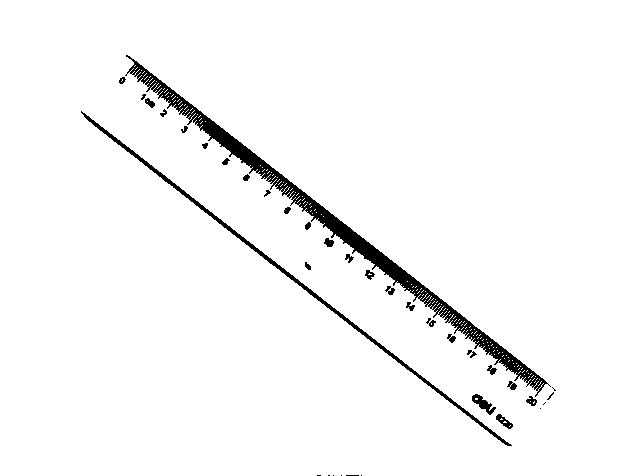

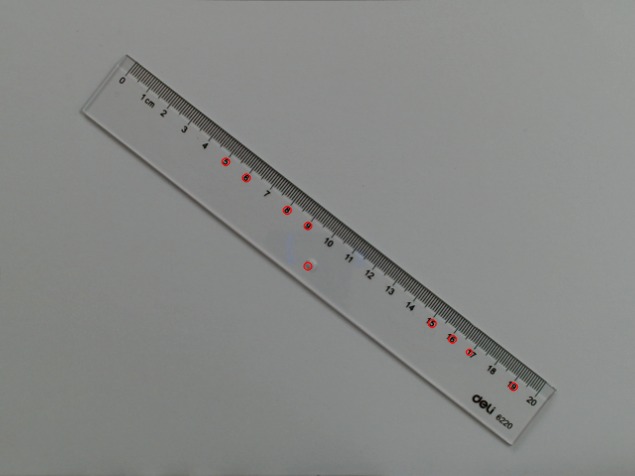

In [ ]:
# Undistort ruler image
ruler_img = undistort_image('/content/CV_Assignment/assign1/data/ruler.png')

# Grayscale
gray = cv.cvtColor(ruler_img, cv.COLOR_BGR2GRAY)

# Thresholding
_, binary_image = cv.threshold(gray, 0, 255, cv.THRESH_BINARY + cv.THRESH_OTSU)
cv_imshow(binary_image)

# Blob detector
params = cv.SimpleBlobDetector_Params()
params.filterByArea = True
params.minArea = 10
params.maxArea = 100
params.filterByColor = True
params.blobColor = 0

detector = cv.SimpleBlobDetector_create(params)
keypoints = detector.detect(binary_image)

image_with_blobs = ruler_img.copy()
image_with_blobs = cv.drawKeypoints(image_with_blobs, keypoints, outImage=image_with_blobs, color=(0, 0, 255), flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv_imshow(image_with_blobs)

##Outlier Removel

While highlighting the keypoints we have an outlier that we needed to remove, we used a linear regression-based approach to filter them by their distance from the regression line.

In [ ]:
from sklearn.linear_model import LinearRegression
#function that removes outlier keypoints based on their distance from the linear regression line
def remove_outliers(keypoints, threshold):
  x = np.array([keypoint.pt[0] for keypoint in keypoints])
  y = np.array([keypoint.pt[1] for keypoint in keypoints])

  regression = LinearRegression()
  regression.fit(x.reshape(-1, 1), y)

  predicted_y = regression.predict(x.reshape(-1, 1))
  distances = np.abs(y - predicted_y)

  filtered_keypoints = [keypoint for keypoint, distance in zip(keypoints, distances) if distance <= threshold]

  return filtered_keypoints

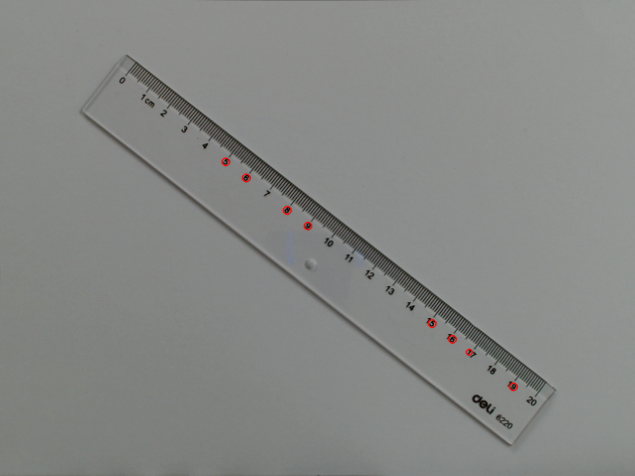

In [ ]:
# Show Keypoints on the image
image_with_filtered_keypoints = ruler_img.copy()
filtered_keypoints = remove_outliers(keypoints, 20)

image_with_filtered_keypoints = cv.drawKeypoints(image_with_filtered_keypoints, filtered_keypoints, outImage=image_with_filtered_keypoints, color=(0, 0, 255), flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv_imshow(image_with_filtered_keypoints)

In [ ]:
for keypoint in filtered_keypoints:
  print("(x, y) = (" + str(keypoint.pt[0]) + ", " + str(keypoint.pt[1]) + ")")

(x, y) = (513.0232543945312, 386.3178405761719)
(x, y) = (468.840576171875, 351.6666564941406)
(x, y) = (452.0823059082031, 338.8312683105469)
(x, y) = (431.7736511230469, 323.0576171875)
(x, y) = (307.5, 225.5)
(x, y) = (286.7854309082031, 209.900390625)
(x, y) = (245.88095092773438, 177.36111450195312)
(x, y) = (225.34901428222656, 161.31764221191406)


##Conersion from Pixels to Millimeters

In this code, we assign the physical measurements in millimeters to the respective keypoints in an array. For each pair of distinct keypoints, we calculate the norm (Euclidean distance) between them in both pixels and millimeters. Using these distances, we compute the conversion rate between pixels and millimeters. These rates are stored in a list, and after iterating over all keypoint pairs, we determine the median conversion rate.

point1 (x, y) = (513.0232543945312, 386.3178405761719)  
point2 (x, y) = (468.840576171875, 351.6666564941406)  
distance in mm = 20 | distance in pixel = 56.14992086560407
rate = 2.8074960432802034
point1 (x, y) = (513.0232543945312, 386.3178405761719)  
point2 (x, y) = (452.0823059082031, 338.8312683105469)  
distance in mm = 30 | distance in pixel = 77.2578393947936
rate = 2.575261313159787
point1 (x, y) = (513.0232543945312, 386.3178405761719)  
point2 (x, y) = (431.7736511230469, 323.0576171875)  
distance in mm = 40 | distance in pixel = 102.97258807545954
rate = 2.5743147018864887
point1 (x, y) = (513.0232543945312, 386.3178405761719)  
point2 (x, y) = (307.5, 225.5)  
distance in mm = 100 | distance in pixel = 260.963955259155
rate = 2.60963955259155
point1 (x, y) = (513.0232543945312, 386.3178405761719)  
point2 (x, y) = (286.7854309082031, 209.900390625)  
distance in mm = 110 | distance in pixel = 286.8913895938761
rate = 2.6081035417625102
point1 (x, y) = (513.0232543945312

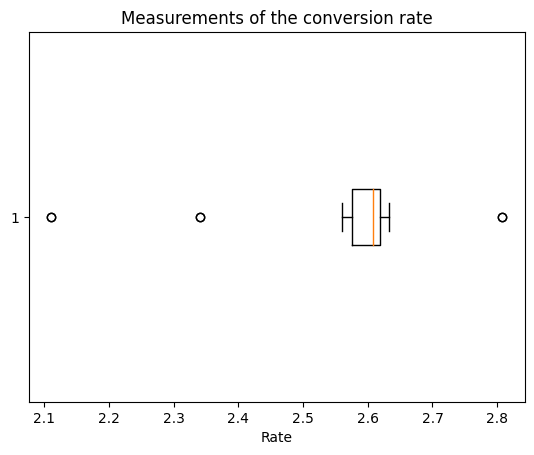

In [ ]:

from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import matplotlib.pylab as plt


point_to_mm = { # the lower the key the lower the y coordinate in pixel and the associated value is the respective ruler mark measure in mm
  0: 190,
  1: 170,
  2: 160,
  3: 150,
  4: 90,
  5: 80,
  6: 60,
  7: 50,
}

rates=[]

for i in range(len(filtered_keypoints)):
  for j in range(len(filtered_keypoints)):
    if(i != j):

      print("point1 (x, y) = (" + str(filtered_keypoints[i].pt[0]) + ", " + str(filtered_keypoints[i].pt[1]) + ")  " )
      print("point2 (x, y) = (" + str(filtered_keypoints[j].pt[0]) + ", " + str(filtered_keypoints[j].pt[1]) + ")  " )

      point1 = (filtered_keypoints[i].pt[0], filtered_keypoints[i].pt[1])
      point2 = (filtered_keypoints[j].pt[0], filtered_keypoints[j].pt[1])

      distance_in_mm = np.abs(point_to_mm.get(i) - point_to_mm.get(j))
      distance_in_pixel = cv.norm(point1, point2)
      rate = distance_in_pixel / distance_in_mm
      rates.append(rate)

      print("distance in mm = " + str(distance_in_mm) + " | distance in pixel = " + str(distance_in_pixel))
      print("rate = " + str(rate))

print("")

Conversion_rate = np.median(rates)
print("Median rate: " + str(Conversion_rate))


 # Plotting
plt.boxplot(rates, vert=False)
plt.title("Measurements of the conversion rate")
plt.xlabel('Rate');

#3

## M&M Sorting


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
from matplotlib import colors
import pandas as pd
from google.colab.patches import cv2_imshow # for image display since cv2.imshow crashes the Colab
from skimage import io
from PIL import Image
import matplotlib.pylab as plt
import time

##3-a)

 The following code processes images to identify and highlight M&M. Initially, a bilateral filter (bilateralFilter()) is applied to reduce noise while preserving the edges of the objects. The image is then converted to the HSV color space, where the V (value) channel is maximized for all pixels to effectively remove shadows. Subsequently, the image is transformed to grayscale, and a thresholding technique (threshold()) is employed to generate a binary mask that separates objects from the background. To refine the mask, morphological operations such as erosion (erode()) and dilation (dilate()) are performed. Finally, object contours are detected using the findContours() function, and the regions of interest (ROIs) corresponding to the detected M&Ms are highlighted by drawing rectangles around them (rectangle()).

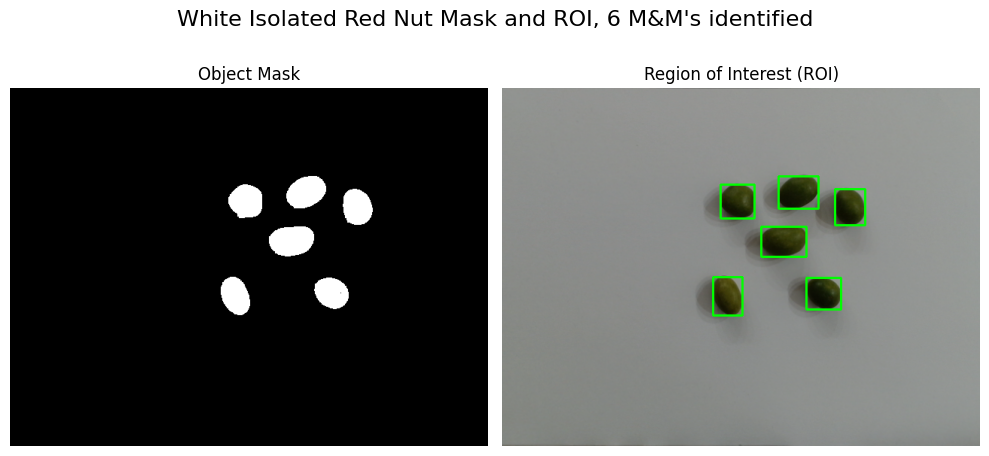

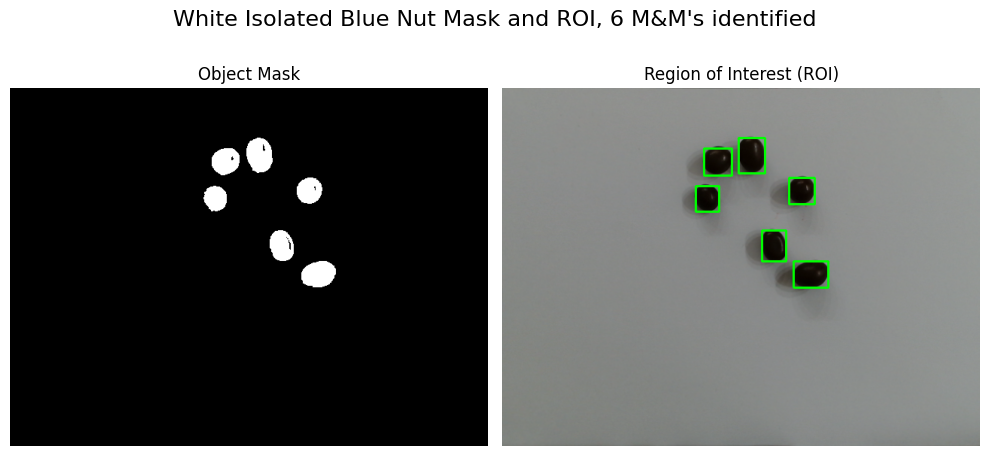

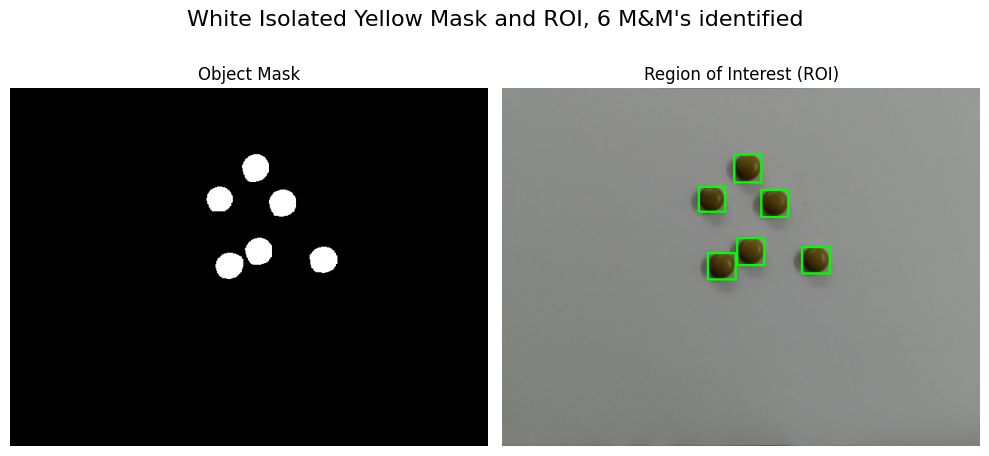

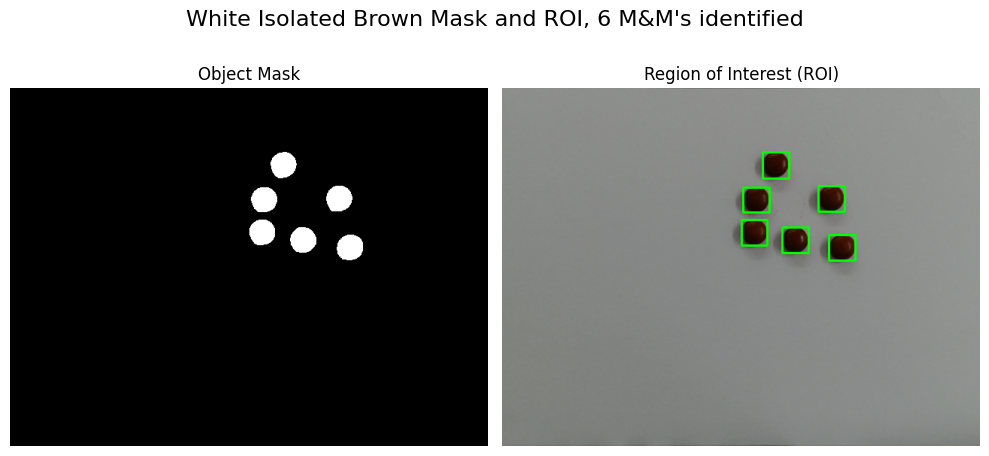

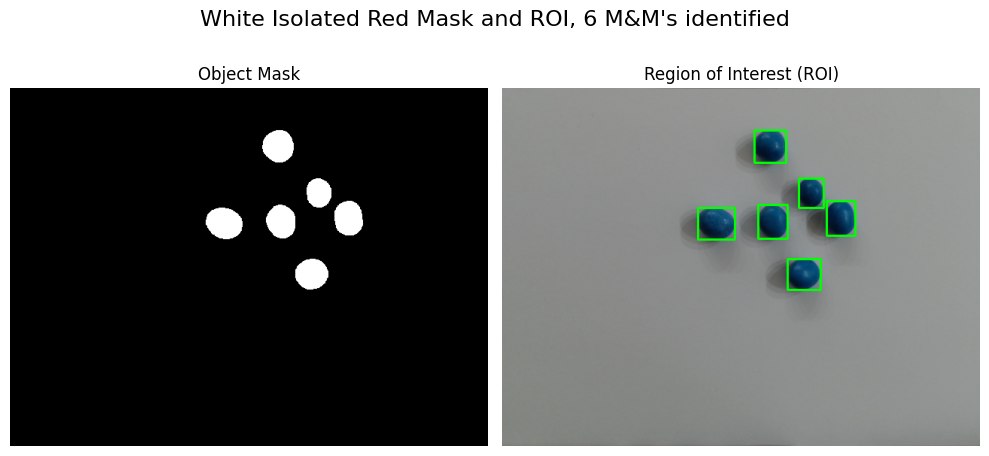

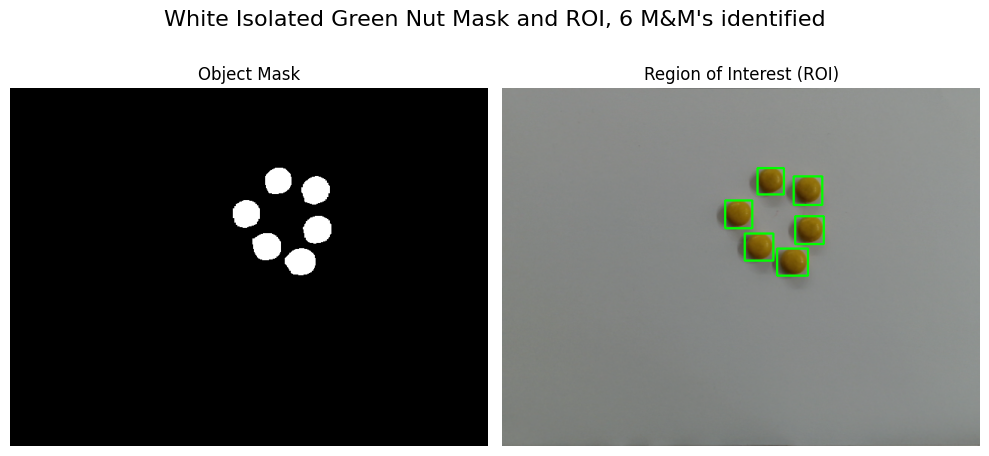

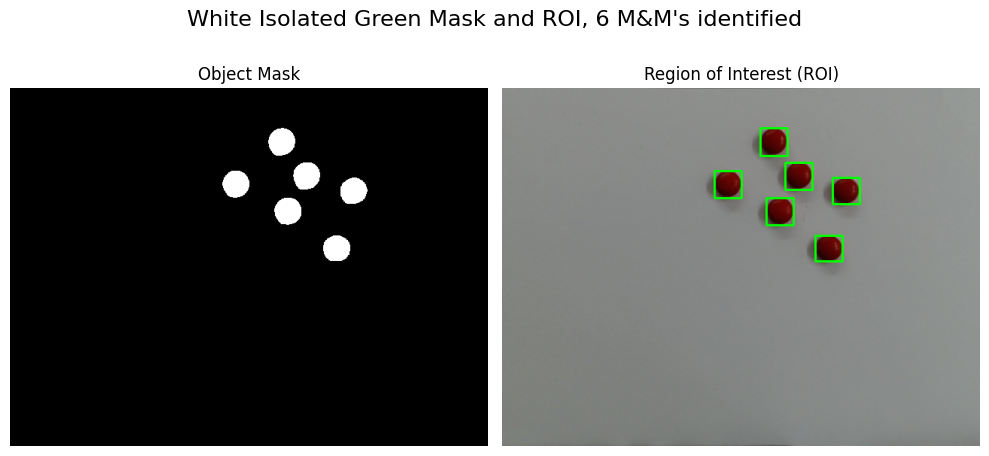

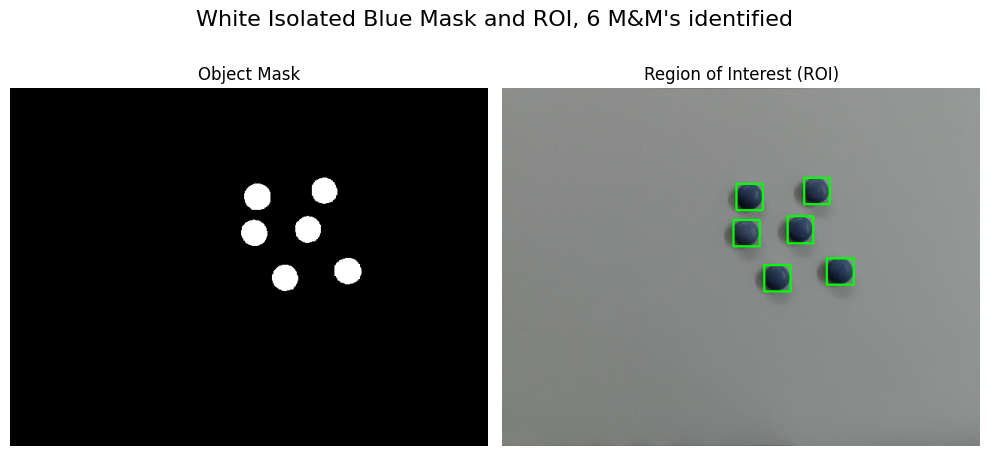

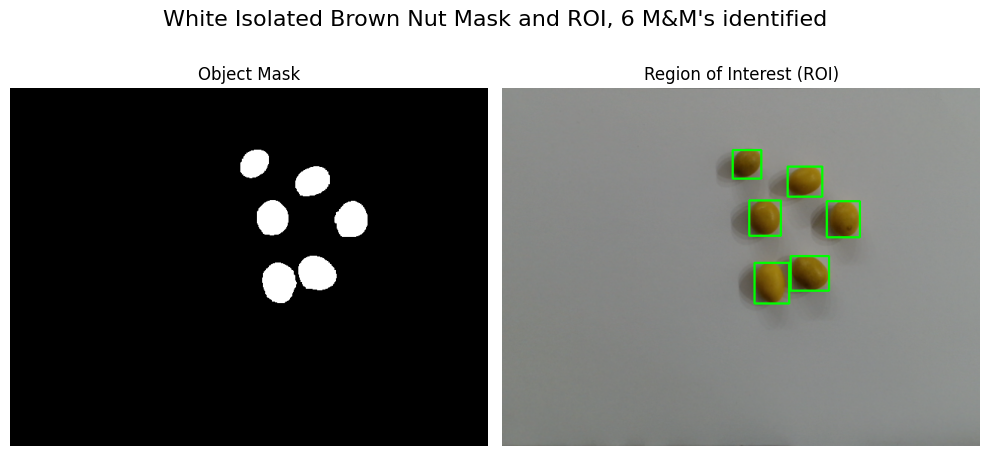

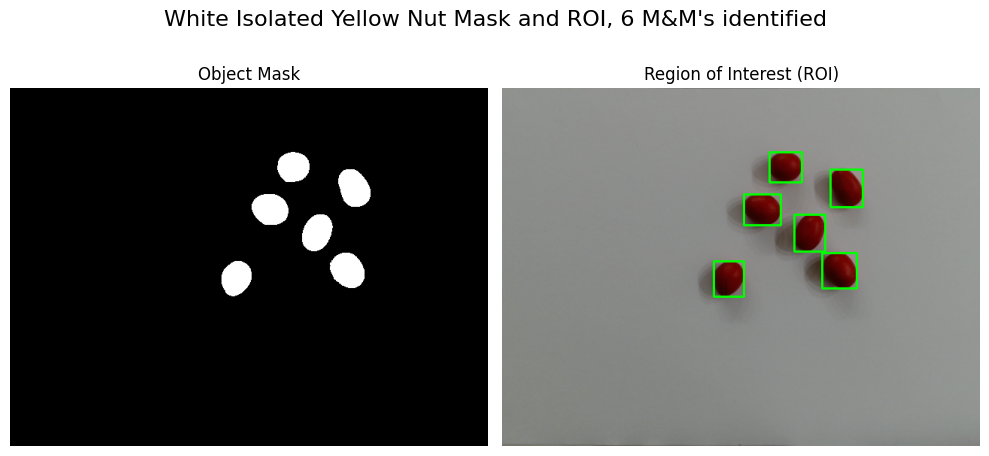

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from google.colab.patches import cv2_imshow
import time

images_desc = ["Red Nut", "Blue Nut", "Yellow", "Brown", "Red", "Green Nut", "Green", "Blue", "Brown Nut", "Yellow Nut"]

# Loop processing the images in `data_images_array`
for image, image_desc in zip(data_images_array, images_desc):
  # Undistord the images with the function created in part (2)
  image_ori=undistort_image(image)

  # Smoth the image without compromising the edges
  image=cv2.bilateralFilter(image_ori, d=9, sigmaColor=75, sigmaSpace=75)

  # Convert the image to HSV
  image_hsv = cv2.cvtColor(image_ori, cv2.COLOR_RGB2HSV)

  # Maximize the V channel to remove the shadows
  v = 255
  image_hsv[:, :, 2] = cv2.add(image_hsv[:, :, 2], v)

  # Convert the image with no shadow to gray
  image_bgr = cv2.cvtColor(image_hsv, cv2.COLOR_HSV2BGR)
  image_gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)

  # Add the variable (per image) value to the image to remove anyn left shadows
  non_white_pixels = image_gray[image_gray <= 255]
  if non_white_pixels.size > 0:
    sorted_pixels = np.sort(non_white_pixels)
    lowest_100_pixels = sorted_pixels[:10000] if sorted_pixels.size >= 10000 else sorted_pixels
    average_value = np.mean(lowest_100_pixels)
  image_gray = cv2.add(image_gray, np.full(image_gray.shape, (255-average_value)/2, dtype=np.uint8))

  threshold=254
  max_value=255

  # Use a threshold to differentiate the backgroud to the M&M
  background_mask = cv2.threshold(image_gray, threshold, max_value, cv2.THRESH_BINARY)[1]
  object_mask = cv2.bitwise_not(background_mask)

  # Morphological operations to correct imperfections in the image
  kernel_3 = np.ones((3, 3), np.uint8)
  object_mask_clean = cv2.erode(object_mask, kernel_3, iterations=1)
  object_mask_clean = cv2.dilate(object_mask_clean, kernel_3, iterations=1)

  # Find the contours in the filtered mask
  contours,_=cv2.findContours(object_mask_clean , cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

  true_contours = 0;

  for c in contours:
    # Consider only contours with area higher than 200
    if (cv2.contourArea(c) < 200):
      continue
    # Highlight the ROI's
    x,y,w,h = cv2.boundingRect(c)
    ROI=cv2.rectangle(image_ori,(x,y),(x+w,y+h),(0,255,0),2)
    true_contours += 1

  # Show image with centroid
  fig, axes = plt.subplots(1, 2, figsize=(10, 5))  # 1 row, 2 columns

  # Plot configurations
  axes[0].imshow(object_mask_clean, cmap='gray')
  axes[0].set_title("Object Mask")
  axes[0].axis('off')
  ROI = cv2.cvtColor(ROI, cv2.COLOR_BGR2RGB)
  axes[1].imshow(ROI)
  axes[1].set_title("Region of Interest (ROI)")
  axes[1].axis('off')

  plt.suptitle("White Isolated " + str(image_desc) + " Mask and ROI, " + str(true_contours) + " M&M's identified", fontsize=16)
  plt.tight_layout()
  plt.show()
  print("\n\n")


##3-b

The following code computes the histograms for each HSV channel using the calcHist() function. The resulting histograms are then plotted for visualization.

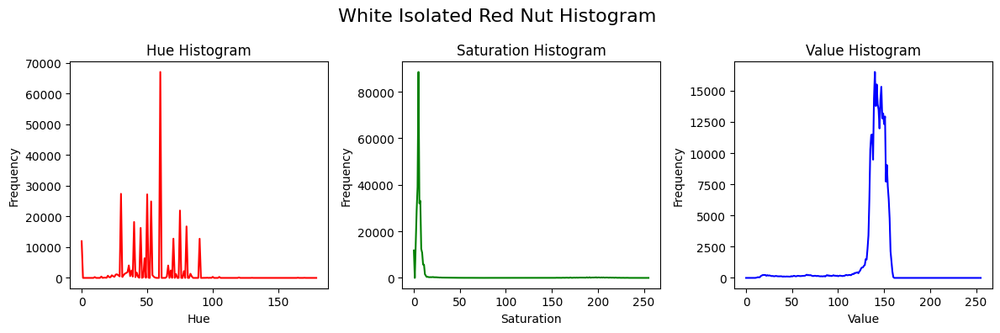

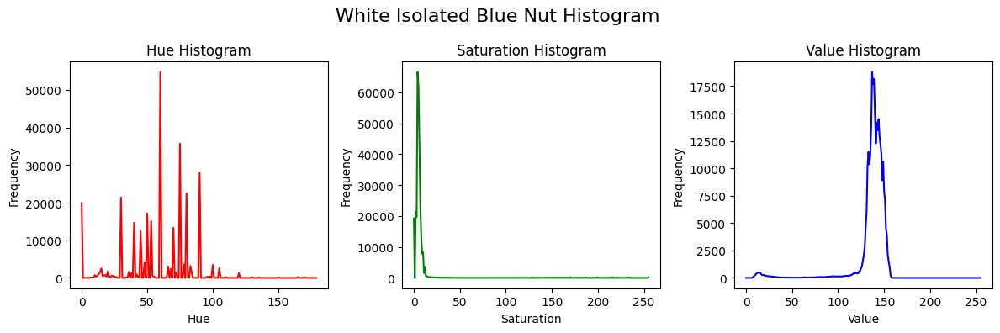

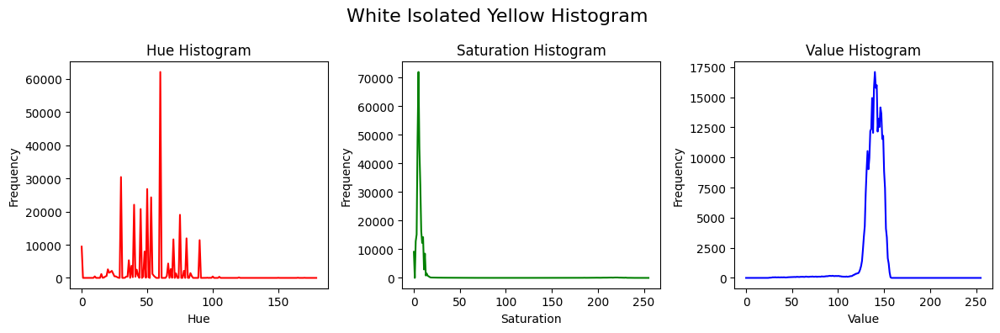

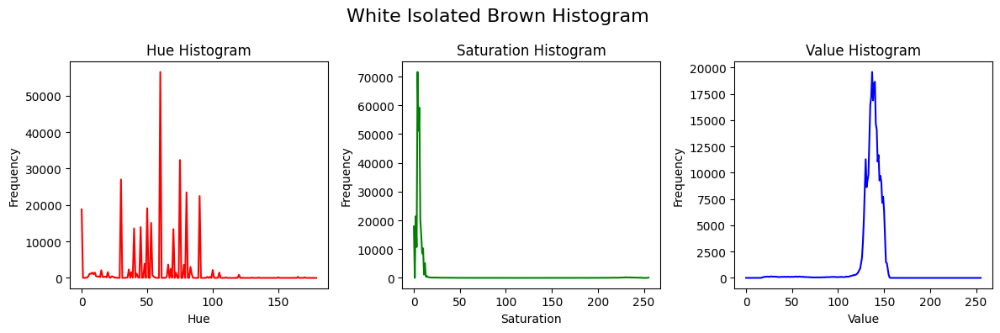

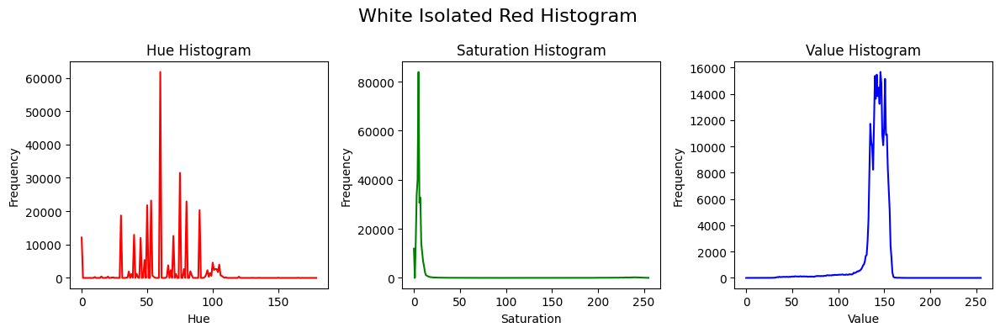

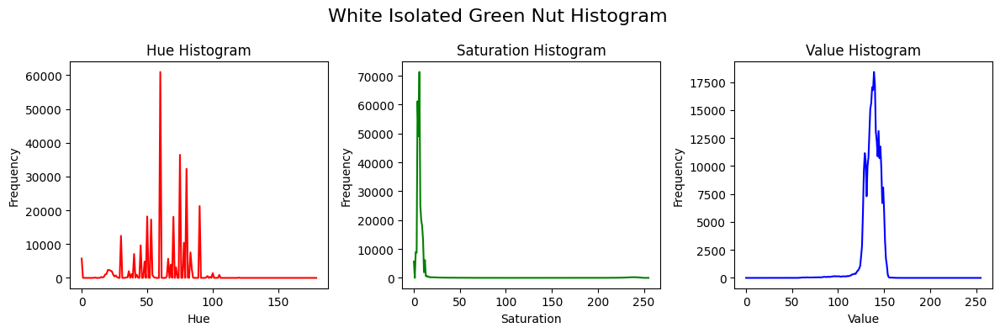

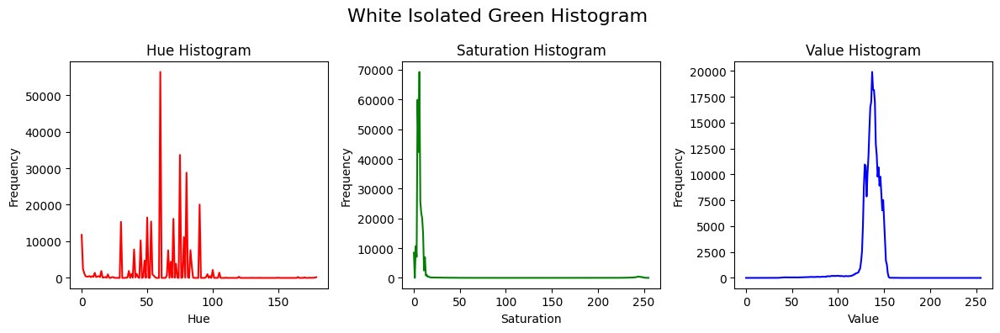

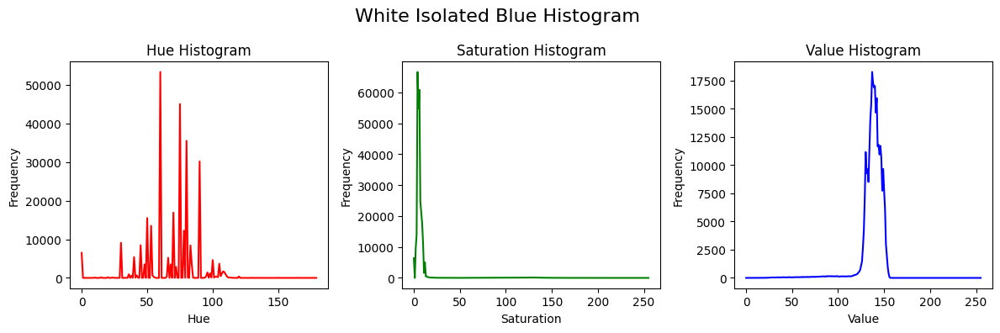

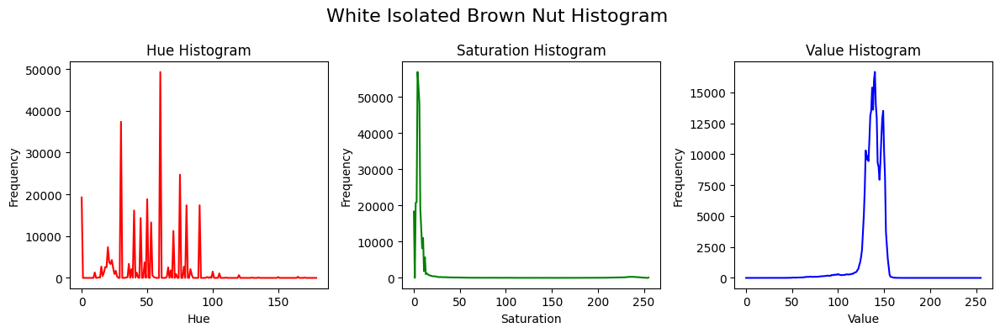

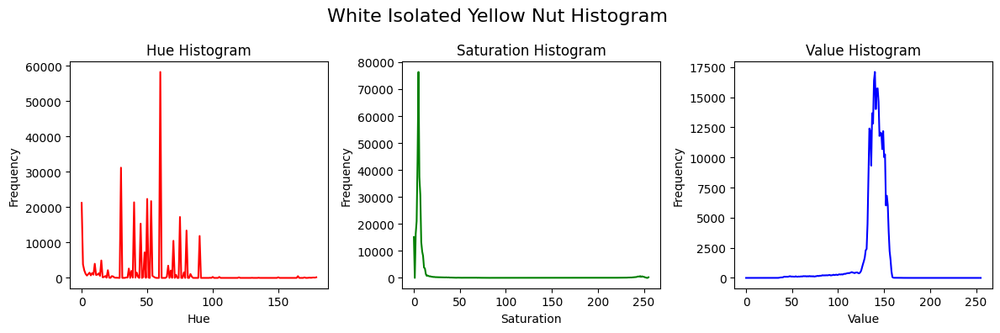

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
from matplotlib import colors
import pandas as pd
from google.colab.patches import cv2_imshow
from skimage import io
from PIL import Image
import matplotlib.pylab as plt
import time

images_desc = ["Red Nut", "Blue Nut", "Yellow", "Brown", "Red", "Green Nut", "Green", "Blue", "Brown Nut", "Yellow Nut"]

# Loop processing the images in `data_images_array`
for image, image_desc in zip(data_images_array, images_desc):
  # Convert the image to HSV
  hsv_img = cv2.cvtColor(undistort_image(image), cv2.COLOR_BGR2HSV)

  # Calculate the histogram for each channel
  hist_h = cv2.calcHist([hsv_img], [0], None, [180], [0, 180])
  hist_s = cv2.calcHist([hsv_img], [1], None, [256], [0, 256])
  hist_v = cv2.calcHist([hsv_img], [2], None, [256], [0, 256])

  # Plot configurations
  plt.figure(figsize=(12, 4))

  plt.subplot(1, 3, 1)
  plt.plot(hist_h, color='r')
  plt.title('Hue Histogram')
  plt.xlabel('Hue')
  plt.ylabel('Frequency')

  plt.subplot(1, 3, 2)
  plt.plot(hist_s, color='g')
  plt.title('Saturation Histogram')
  plt.xlabel('Saturation')
  plt.ylabel('Frequency')

  plt.subplot(1, 3, 3)
  plt.plot(hist_v, color='b')
  plt.title('Value Histogram')
  plt.xlabel('Value')
  plt.ylabel('Frequency')

  plt.suptitle("White Isolated " + str(image_desc) + " Histogram ", fontsize=16)
  plt.tight_layout()
  plt.show()
  print("\n\n")


## 3-c)

Similar to the approach in part (a), the following code generates a mask to differentiate the M&Ms from the background. However, instead of using the rectangle() function to highlight the regions of interest (ROIs), it calculates the area of each M&M using the contourArea() function and determines their centroids with the moments() function. Finally, the code computes the average area of the detected M&Ms in all images.

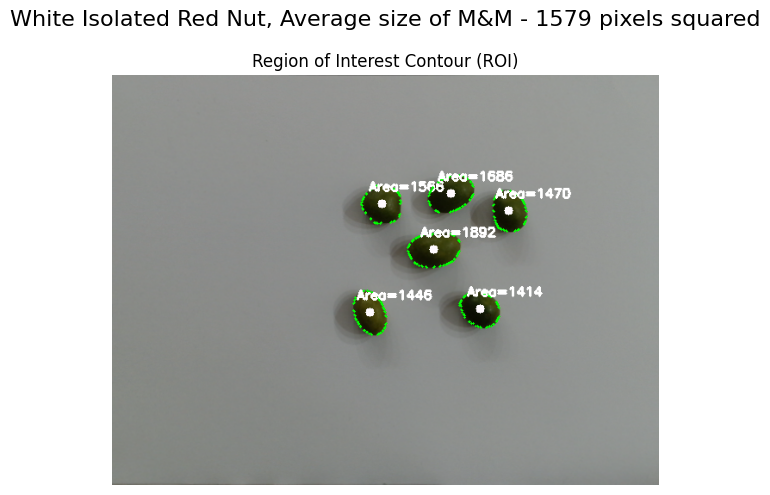

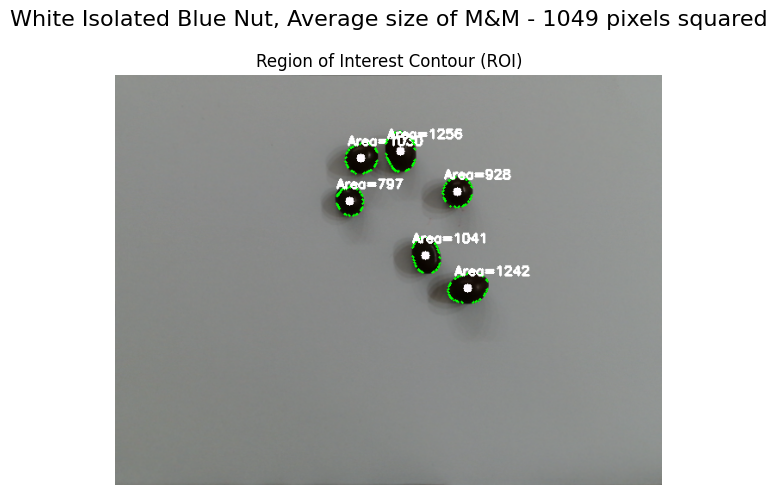

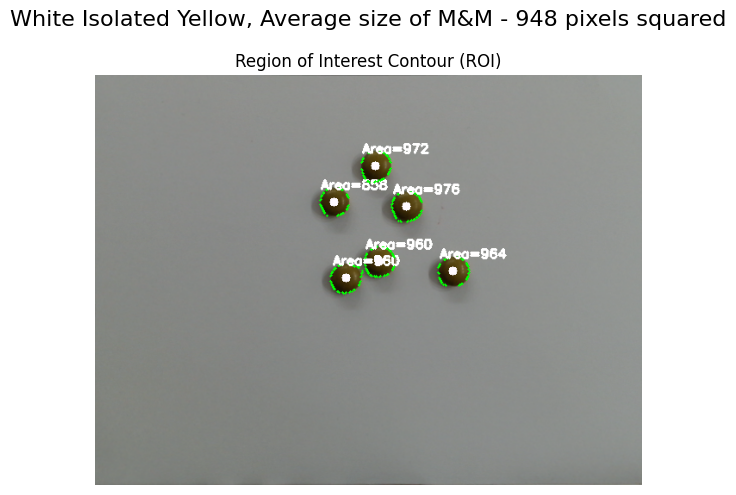

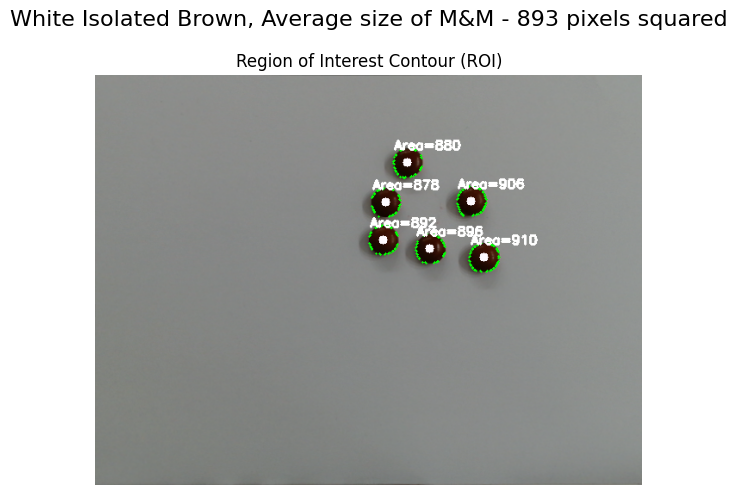

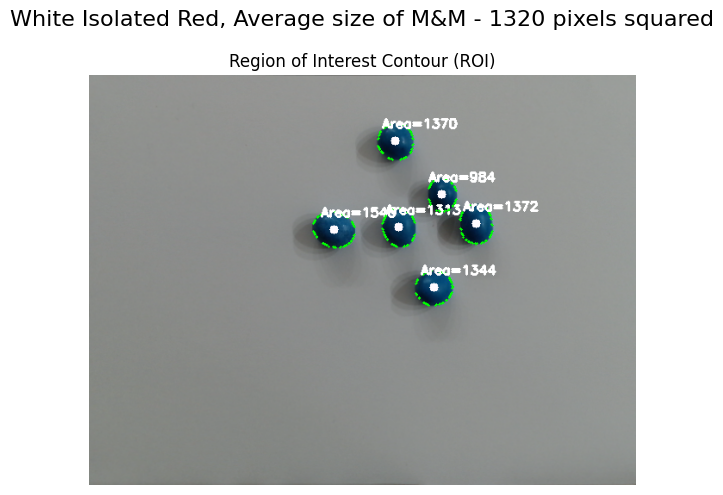

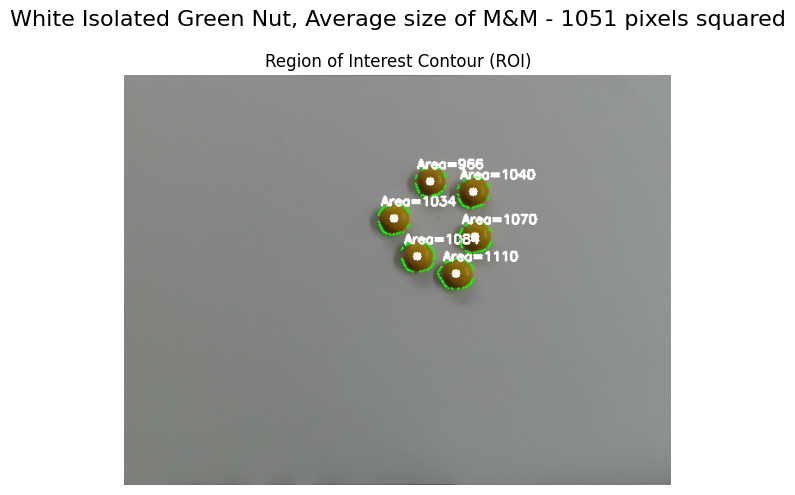

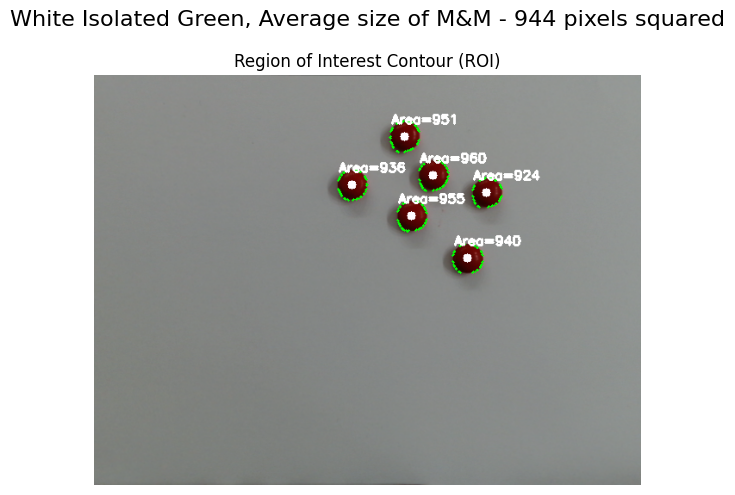

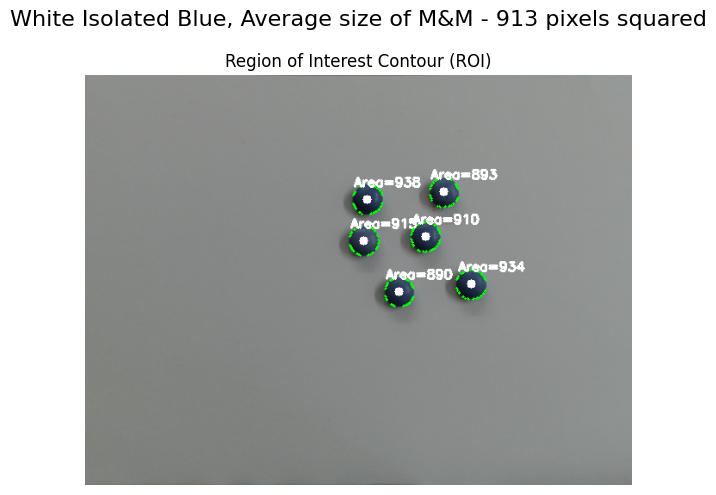

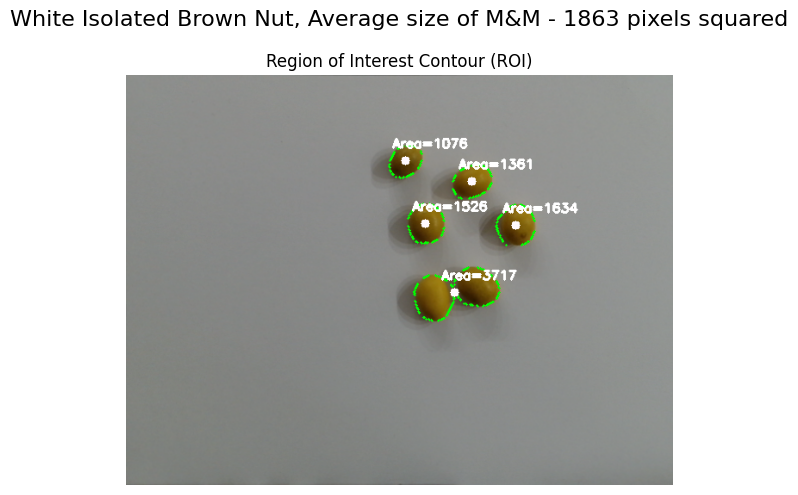

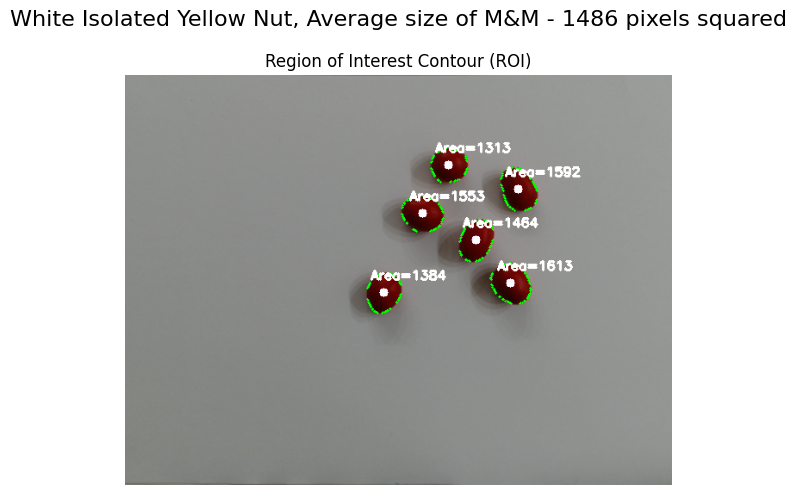




Average size of the contours: 1194


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2

sizes = []
images_desc = ["Red Nut", "Blue Nut", "Yellow", "Brown", "Red", "Green Nut", "Green", "Blue", "Brown Nut", "Yellow Nut"]

for image, image_desc in zip(data_images_array, images_desc):
    # Undistord the images with the function created in part (2)
    image_ori=undistort_image(image)

    # Smoth the image without compromising the edges
    image=cv2.bilateralFilter(image_ori, d=9, sigmaColor=75, sigmaSpace=75)

    # Convert the image to HSV
    image_hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)

    # Maximize the V channel to remove the shadows
    v = 255
    image_hsv[:, :, 2] = cv2.add(image_hsv[:, :, 2], v)

    # Convert the image with no shadow to gray
    image_bgr = cv2.cvtColor(image_hsv, cv2.COLOR_HSV2BGR)
    image_gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)

    # Add the variable (per image) value to the image to remove anyn left shadows
    non_white_pixels = image_gray[image_gray <= 255]
    if non_white_pixels.size > 0:
      sorted_pixels = np.sort(non_white_pixels)
      lowest_100_pixels = sorted_pixels[:10000] if sorted_pixels.size >= 10000 else sorted_pixels
      average_value = np.mean(lowest_100_pixels)
    image_gray = cv2.add(image_gray, np.full(image_gray.shape, (255-average_value)/2, dtype=np.uint8))

    threshold=254
    max_value=255
    # Use a threshold to differentiate the backgroud to the M&M
    background_mask = cv2.threshold(image_gray, threshold, max_value, cv2.THRESH_BINARY)[1]

    object_mask = cv2.bitwise_not(background_mask)

    # Morphological operations to correct imperfections in the image
    kernel_3 = np.ones((3, 3), np.uint8)
    object_mask_clean = cv2.erode(object_mask, kernel_3, iterations=1)
    object_mask_clean = cv2.dilate(object_mask_clean, kernel_3, iterations=1)

    # Find the contours
    contours,_=cv2.findContours(object_mask , cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    true_contours = 0

    average_size = []
    average_size.clear()
    for c in contours:
      # Consider only contours with area higher than 200
      if (cv2.contourArea(c) < 50):
        continue

      # Storing sizes for different calculations
      sizes.append(cv2.contourArea(c))
      average_size.append(cv2.contourArea(c))

      # Draw contours
      ROI_c = cv2.drawContours(image_ori, c, -1, (0, 255, 0), 2)
      M = cv2.moments(c)

      # Centroid calculation
      if M["m00"] != 0:
        cX = int(M["m10"] / M["m00"])
        cY = int(M["m01"] / M["m00"])
      else:
        cX, cY = 0, 0

      # Draw the centroid on the image
      cv2.circle(ROI_c, (cX, cY), 5, (255, 250, 255), -1)
      cv2.putText(ROI_c, "Area=" + str(round(cv2.contourArea(c))), (cX - 15, cY - 15), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)
      true_contours += 1

    # Plot configurations
    fig, axes = plt.subplots(1, 1, figsize=(10, 5))
    ROI_c = cv2.cvtColor(ROI_c, cv2.COLOR_BGR2RGB)
    axes.imshow(ROI_c)
    axes.set_title("Region of Interest Contour (ROI)")
    axes.axis('off')
    plt.suptitle("White Isolated " + str(image_desc) + ", Average size of M&M - " + str(round(np.mean(average_size))) + " pixels squared", fontsize=16)
    plt.tight_layout()
    plt.subplots_adjust(top=0.85)
    plt.show()
    print("\n\n")

average_size = np.mean(sizes)
print("Average size of the contours:", round(average_size))

## 3-d)

Similar to the approach in part (c), the following code generates a mask to differentiate the M&Ms from the background and calculates the average area and standard deviation of each M&M using the contourArea() function. The code then outputs these values along with the corresponding image.































Red Nut Image

Red Nut - Average Size: 4117.9939954091715
Standard Deviation for Red Nut: 434.0275743121531


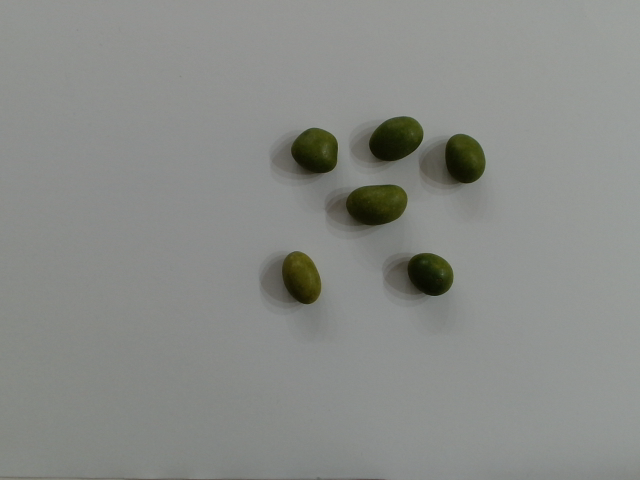


---------------------------------------------------------------------------------------

Blue Nut Image

Blue Nut - Average Size: 2736.199969079475
Standard Deviation for Blue Nut: 424.19079232392676


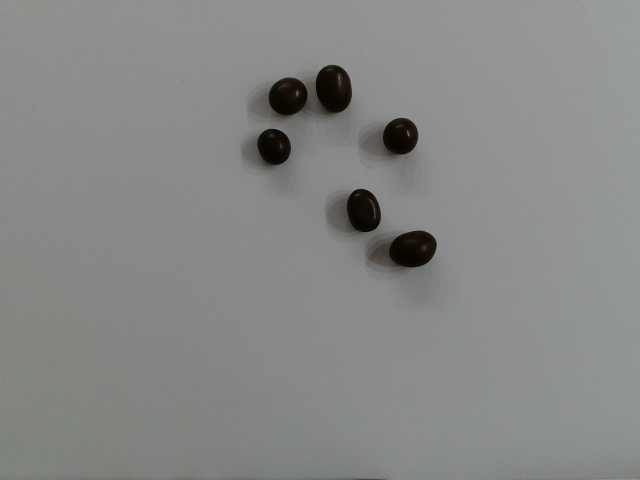


---------------------------------------------------------------------------------------

Yellow Image

Yellow - Average Size: 2473.622151900574
Standard Deviation for Yellow: 105.92293082815631


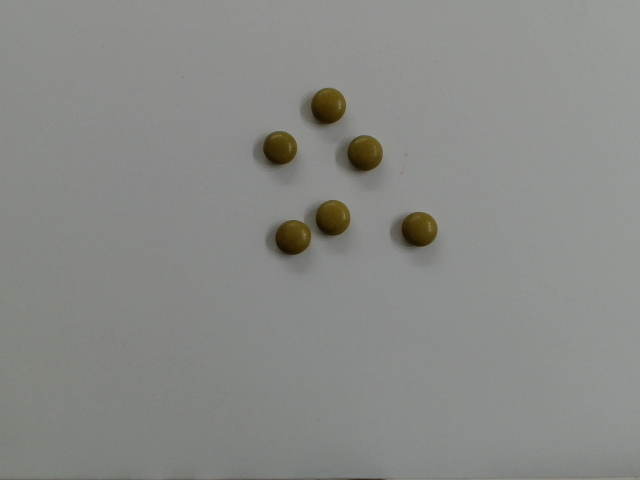


---------------------------------------------------------------------------------------

Brown Image

Brown - Average Size: 2330.3781274627463
Standard Deviation for Brown: 31.131904491687987


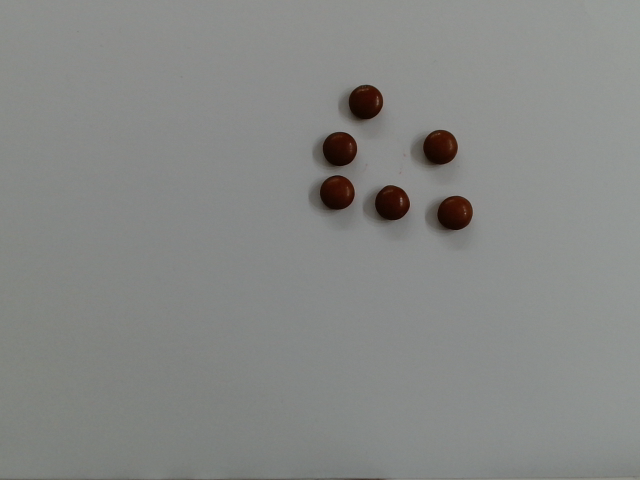


---------------------------------------------------------------------------------------

Red Image

Red - Average Size: 3443.9428273034
Standard Deviation for Red: 434.94097549653935


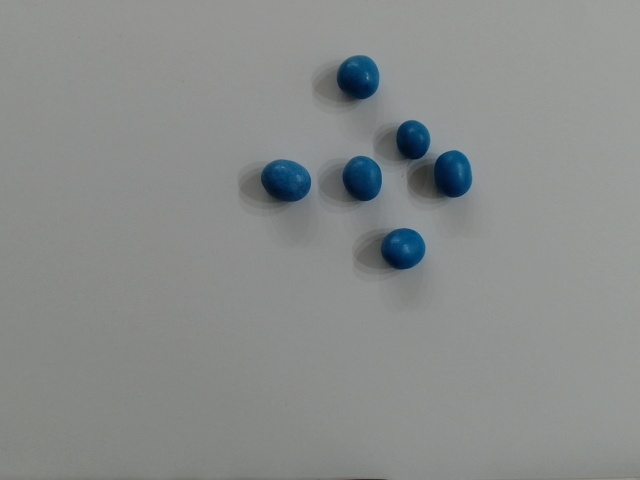


---------------------------------------------------------------------------------------

Green Nut Image

Green Nut - Average Size: 2740.5472839334307
Standard Deviation for Green Nut: 119.81723422910669


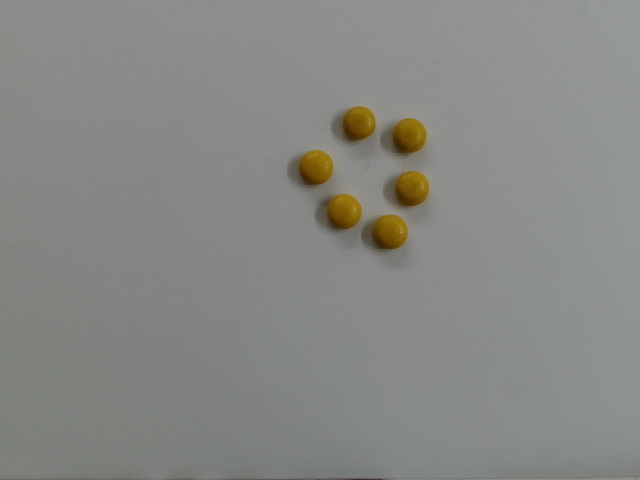


---------------------------------------------------------------------------------------

Green Image

Green - Average Size: 2463.1885962510814
Standard Deviation for Green: 32.12015573013254


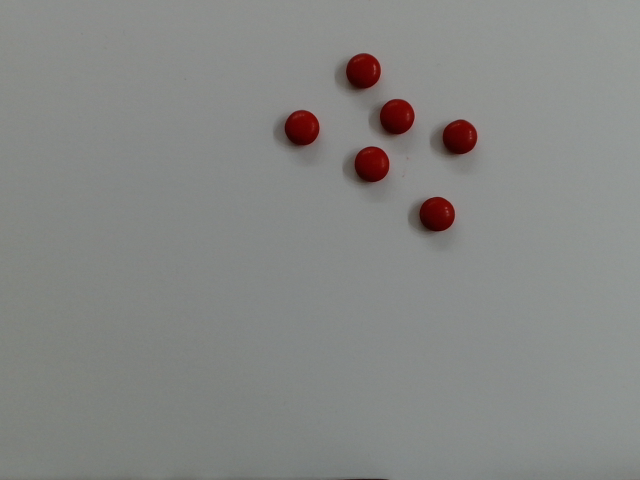


---------------------------------------------------------------------------------------

Blue Image

Blue - Average Size: 2381.8938084821166
Standard Deviation for Blue: 47.41762807119161


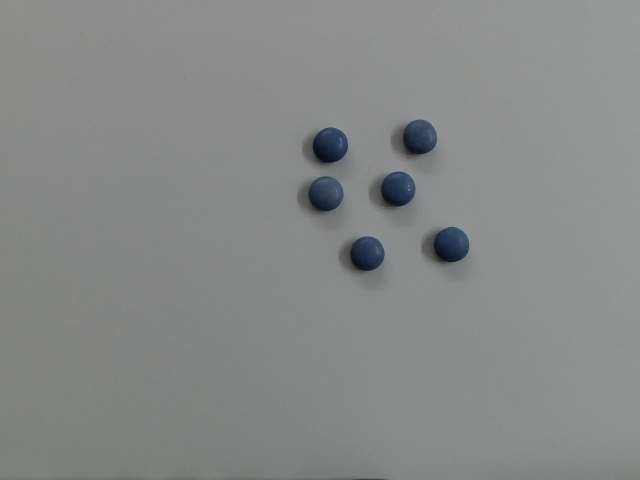


---------------------------------------------------------------------------------------

Brown Nut Image

Brown Nut - Average Size: 4858.9068659687755
Standard Deviation for Brown Nut: 2467.44472609957


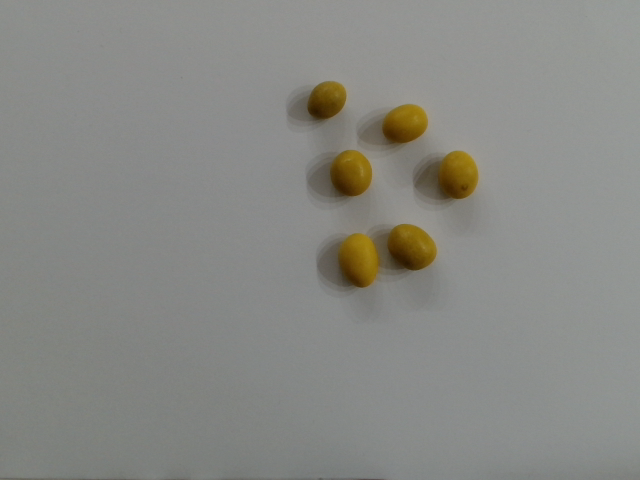


---------------------------------------------------------------------------------------

Yellow Nut Image

Yellow Nut - Average Size: 3877.370118242745
Standard Deviation for Yellow Nut: 286.649955446704


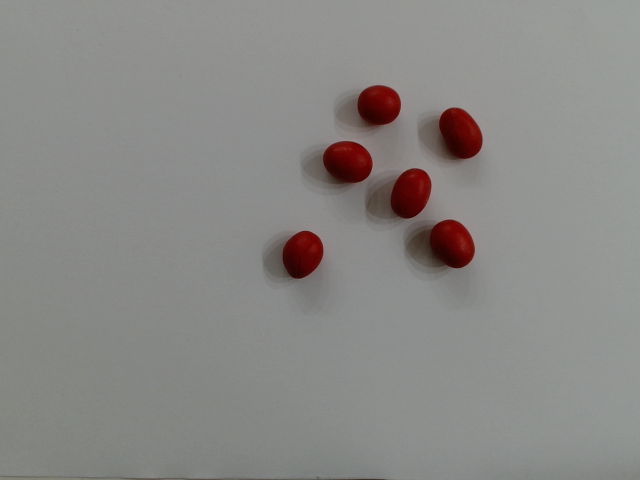


---------------------------------------------------------------------------------------



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from google.colab.patches import cv2_imshow


sizes=[]
sizes_vector = [[] for _ in range(len(data_images_array))]  # Initialize a vector of lists to store the sizes.
images_desc = ["Red Nut", "Blue Nut", "Yellow", "Brown", "Red", "Green Nut", "Green", "Blue", "Brown Nut", "Yellow Nut"]

# Primeiro loop para processar as imagens e calcular os contornos
for image, image_desc, size_vector in zip(data_images_array, images_desc, sizes_vector):
  # Undistord the images with the function created in part (2)
  image_ori=undistort_image(image)

  # Smoth the image without compromising the edges
  image=cv2.bilateralFilter(image_ori, d=9, sigmaColor=75, sigmaSpace=75)

  # Convert the image to HSV
  image_hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)

  # Maximize the V channel to remove the shadows
  v = 255
  image_hsv[:, :, 2] = cv2.add(image_hsv[:, :, 2], v)

  # Convert the image with no shadow to gray
  image_bgr = cv2.cvtColor(image_hsv, cv2.COLOR_HSV2BGR)
  image_gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)

  # Add the variable (per image) value to the image to remove anyn left shadows
  non_white_pixels = image_gray[image_gray <= 255]
  if non_white_pixels.size > 0:
    sorted_pixels = np.sort(non_white_pixels)
    lowest_100_pixels = sorted_pixels[:10000] if sorted_pixels.size >= 10000 else sorted_pixels
    average_value = np.mean(lowest_100_pixels)
  image_gray = cv2.add(image_gray, np.full(image_gray.shape, (255-average_value)/2, dtype=np.uint8))

  threshold=254
  max_value=255
  # Use a threshold to differentiate the backgroud to the M&M
  background_mask = cv2.threshold(image_gray, threshold, max_value, cv2.THRESH_BINARY)[1]

  object_mask = cv2.bitwise_not(background_mask)

  # Morphological operations to correct imperfections in the image
  kernel_3 = np.ones((3, 3), np.uint8)
  object_mask_clean = cv2.erode(object_mask, kernel_3, iterations=1)
  object_mask_clean = cv2.dilate(object_mask_clean, kernel_3, iterations=1)

  # Find the contours
  contours,_=cv2.findContours(object_mask , cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

  true_contours = 0;

  for c in contours:
    if (cv2.contourArea(c) < 50):
      # Consider only contours with area higher than 50
      continue

    # Storing sizes for sies calculations
    size_vector.append(cv2.contourArea(c))
    true_contours += 1

# Second loop to output the results
for image_path, image_desc, size_vector in zip(data_images_array, images_desc, sizes_vector):
  print(image_desc + " Image" + "\n")
  image = cv2.imread(image_path)

  # Average size of the contours
  average_size = np.sum(size_vector) / len(size_vector) if len(size_vector) > 0 else 0
  print(f"{image_desc} - Average Size: {average_size*Conversion_rate**2}")

  # Std dev of the contours
  std_dev = np.std(size_vector) if len(size_vector) > 0 else 0
  print(f"Standard Deviation for {image_desc}: {std_dev*Conversion_rate**2}")

  # Image show
  cv2_imshow(image)
  print("\n---------------------------------------------------------------------------------------\n")



# 4

##4-a)

The code first applies a bilateral filter to preserve the edges while blurring the interior of the contours. The image is then converted to the HSV color space, and the V (value) channel is maximized to remove the shadows. Subsequently, the image is transformed to grayscale, and edge detection is performed using the Canny algorithm (Canny()). Since edge filling is not perfect for detecting all M&Ms during mask construction, the initial mask is combined with another mask representing all potential M&M values in the image. After this conjunction, the final mask is created (more robust than the edge or the color alone). The contours are then identified, with contours having an area less than 200 discarded. The median HSV values of each contour are passed to the classify_color() function, which determines the color of each M&M. Finally, the difference between an M&M with or without a nut is determined based on the contour area and the counters of each type and color is printed.

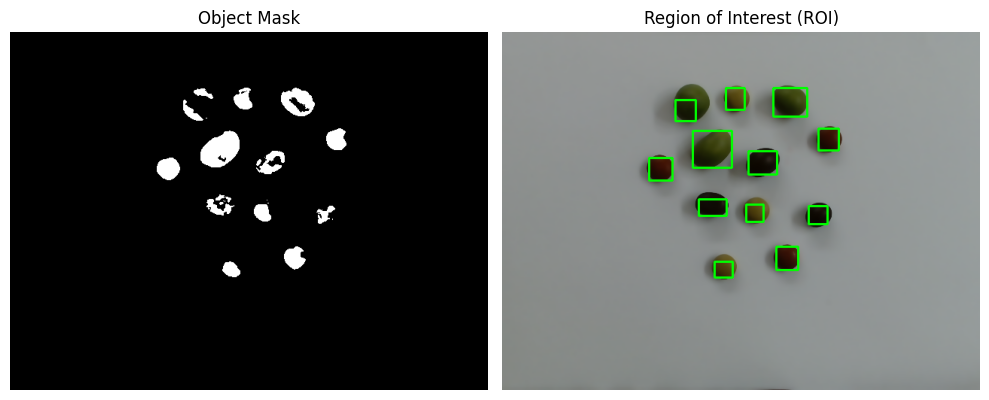

Number of M&Ms: 12
Number of Red: 0
Number of Red Nuts: 0
Number of Blue: 0
Number of Blue Nuts: 0
Number of Brown: 3
Number of Brown Nuts: 3
Number of Green: 3
Number of Green Nuts: 3
Number of Yellow: 0
Number of Yellow Nuts: 0



---------------------------------------------------------------------------------------



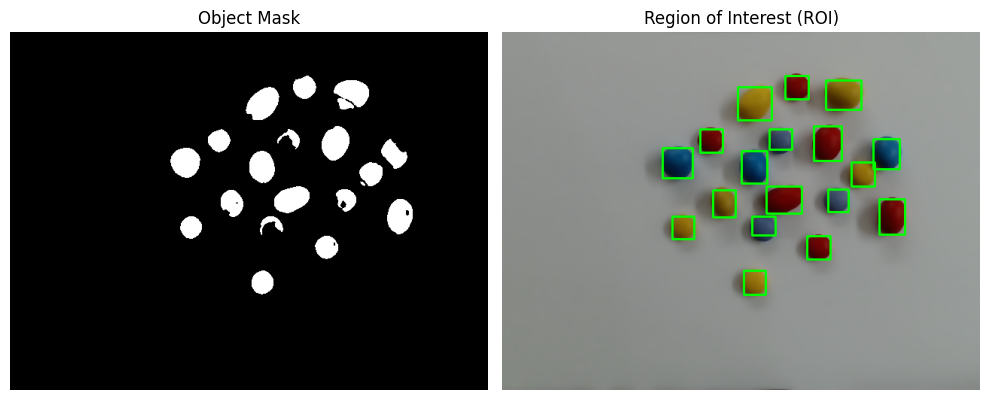

Number of M&Ms: 18
Number of Red: 3
Number of Red Nuts: 3
Number of Blue: 3
Number of Blue Nuts: 3
Number of Brown: 0
Number of Brown Nuts: 0
Number of Green: 0
Number of Green Nuts: 0
Number of Yellow: 3
Number of Yellow Nuts: 3



---------------------------------------------------------------------------------------



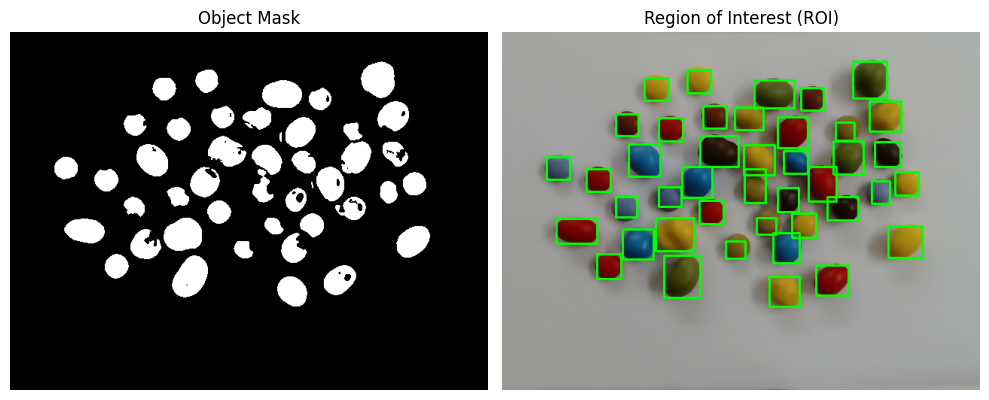

Number of M&Ms: 42
Number of Red: 4
Number of Red Nuts: 4
Number of Blue: 4
Number of Blue Nuts: 5
Number of Brown: 3
Number of Brown Nuts: 4
Number of Green: 4
Number of Green Nuts: 4
Number of Yellow: 4
Number of Yellow Nuts: 6



---------------------------------------------------------------------------------------



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
from matplotlib import colors
import pandas as pd
from google.colab.patches import cv2_imshow # for image display since cv2.imshow crashes the Colab
from skimage import io
from PIL import Image
import matplotlib.pylab as plt
import time

blue_cnt=0
blue_nut_cnt=0
brown_cnt=0
brown_nut_cnt=0
green_cnt=0
green_nut_cnt=0
red_cnt=0
red_nut_cnt=0
yellow_cnt=0
yellow_nut_cnt=0

def classify_color(median_hsv, area):
    median_h, median_s = median_hsv
    global blue_cnt, blue_nut_cnt, brown_cnt, brown_nut_cnt, green_cnt, green_nut_cnt, red_cnt, red_nut_cnt, yellow_cnt, yellow_nut_cnt

    if (median_h >= 101 and median_h <= 107 and median_s > 147 and median_s < 250):
        blue_nut_cnt += 1
        return "Blue Nut"
    elif (median_h >= 106 and median_h <= 110 and median_s > 61 and median_s < 114):
        blue_cnt += 1
        return "Blue"
    elif (median_h >= 0 and median_h <= 2 and median_s > 217 and median_s < 254):
        if(area > 895):
            red_nut_cnt += 1
            return "Red Nut"
        else:
            red_cnt += 1
        return "Red"
    elif (median_h >= 5 and median_h <= 11 and median_s > 191 and median_s < 243):
        brown_cnt +=1
        return "Brown"
    elif (median_h >= 12 and median_h <= 17 and median_s > 127  and median_s < 255):
        brown_nut_cnt +=1
        return "Brown Nut"
    elif (median_h >= 21 and median_h <= 24 and median_s >= 216  and median_s <= 235):
        if(area > 720):
            yellow_nut_cnt += 1
            return "Yellow Nut"
        else:
            yellow_cnt += 1
        return "Yellow"
    elif (median_h >= 21 and median_h <= 24 and median_s >= 202  and median_s < 216):
        green_cnt += 1
        return "Green"
    elif (median_h >= 25 and median_h <= 35 and median_s > 133  and median_s < 231):
        green_nut_cnt += 1
        return "Green Nut"
    else:
        print(median_h)
        print(median_s)
        return "Unknown"





#RED
light_color_r = (0, 217, 0)
dark_color_r = (2,254, 255)

#BLUE
light_color_b = (101, 147, 0)
dark_color_b = (107,250, 255)

#LBLUE
light_color_lb = (106, 61, 0)
dark_color_lb = (110,114, 255)

#LBrown
light_color_lbrown = (5, 191, 0)
dark_color_lbrown = (11,243, 255)

#DBROWN
light_color_dbrown = (12, 127, 0)
dark_color_dbrown = (17,255, 255)

#YELLOW and LGREEN
light_color_yg = (19, 191, 0)
dark_color_yg = (24,253, 255)

#DGREEN
light_color_dg = (25, 133, 0)
dark_color_dg = (35,231, 255)


for image in data_images_array_mix:
  blue_cnt=0
  blue_nut_cnt=0
  brown_cnt=0
  brown_nut_cnt=0
  green_cnt=0
  green_nut_cnt=0
  red_cnt=0
  red_nut_cnt=0
  yellow_cnt=0
  yellow_nut_cnt=0


  image_ori=undistort_image(image)
  #cv2_imshow(image_ori)
  #print("\n\n")

  image=cv2.bilateralFilter(image_ori, d=9, sigmaColor=75, sigmaSpace=75)
  #cv2_imshow(image)
  #print("\n\n")

  image_hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
  image_hsv[:, :, 2] = cv2.add(image_hsv[:, :, 2], 255)

  image_bgr = cv2.cvtColor(image_hsv, cv2.COLOR_HSV2BGR)
  image_gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)

  #cv2_imshow(image_gray)
  #print("\n\n")

  kernel_3 = np.ones((3, 3), np.uint8)
  edges = cv2.Canny(image_gray, 50, 200)
  edges = cv2.dilate(edges, kernel_3, iterations=1)
  #print("edges")
  #cv2_imshow(edges)

  object_mask_r = cv2.inRange(image_hsv, light_color_r, dark_color_r)
  object_mask_b = cv2.inRange(image_hsv, light_color_b, dark_color_b)
  object_mask_lb = cv2.inRange(image_hsv, light_color_lb, dark_color_lb)
  object_mask_lbrown = cv2.inRange(image_hsv, light_color_lbrown, dark_color_lbrown)
  object_mask_dbrown = cv2.inRange(image_hsv, light_color_dbrown, dark_color_dbrown)
  object_mask_yg = cv2.inRange(image_hsv, light_color_yg, dark_color_yg)
  object_mask_dg = cv2.inRange(image_hsv, light_color_dg, dark_color_dg)

  kernel_3 = np.ones((3, 3), np.uint8)

  object_mask_r_clean = cv2.medianBlur(object_mask_r, 3)
  object_mask_r_clean = cv2.erode(object_mask_r_clean, kernel_3, iterations=1)
  object_mask_r_clean = cv2.dilate(object_mask_r_clean, kernel_3, iterations=1)
  object_mask_b_clean = cv2.medianBlur(object_mask_b, 3)
  object_mask_b_clean = cv2.erode(object_mask_b_clean, kernel_3, iterations=1)
  object_mask_b_clean = cv2.dilate(object_mask_b_clean, kernel_3, iterations=1)
  object_mask_lb_clean = cv2.medianBlur(object_mask_lb, 3)
  object_mask_lb_clean = cv2.erode(object_mask_lb_clean, kernel_3, iterations=1)
  object_mask_lb_clean = cv2.dilate(object_mask_lb_clean, kernel_3, iterations=1)
  object_mask_lbrown_clean = cv2.medianBlur(object_mask_lbrown, 3)
  object_mask_lbrown_clean = cv2.erode(object_mask_lbrown_clean, kernel_3, iterations=1)
  object_mask_lbrown_clean = cv2.dilate(object_mask_lbrown_clean, kernel_3, iterations=1)
  object_mask_dbrown_clean = cv2.medianBlur(object_mask_dbrown, 3)
  object_mask_dbrown_clean = cv2.erode(object_mask_dbrown_clean, kernel_3, iterations=1)
  object_mask_dbrown_clean = cv2.dilate(object_mask_dbrown_clean, kernel_3, iterations=1)

  object_mask  = cv2.bitwise_or(object_mask_r, object_mask_b)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_lb)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_lbrown)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_dbrown)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_yg)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_dg)


  #cv2_imshow(object_mask)
  #print("image_gray_filtered")
  mask_inversed = cv2.bitwise_not(object_mask)
  object_mask = cv2.subtract(object_mask ,edges)
  object_mask = cv2.medianBlur(object_mask, 3)
  #cv2_imshow(object_mask)
  #print("\n\n")

  non_white_pixels = image_gray[image_gray <= 255]

  kernel_3 = np.ones((5, 5), np.uint8)

  object_mask_clean = object_mask

  contours,_=cv2.findContours(object_mask , cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

  true_contours = 0;

  # Consider only contours with area higher than 20
  for c in contours:
    if (cv2.contourArea(c) < 200):
      continue
    mask = np.zeros(image_hsv.shape[:2], dtype=np.uint8)
    cv2.drawContours(mask, [c], -1, 255, thickness=cv2.FILLED)

    h_channel = image_hsv[:, :, 0][mask == 255]  # Extract hue channel where mask is white
    s_channel = image_hsv[:, :, 1][mask == 255]  # Extract saturation channel where mask is white

    # Compute the median for each channel
    median_h = np.median(h_channel)
    median_s = np.median(s_channel)

    # Combine the medians into a tuple
    median_hsv = (median_h, median_s)

    # Classify the color based on the median HSV values
    color_class = classify_color(median_hsv, cv2.contourArea(c))

    #print("Color Class: " + color_class)
    #cv2_imshow(mask)
    #print("\n\n")
    x,y,w,h = cv2.boundingRect(c)
    ROI=cv2.rectangle(image,(x,y),(x+w,y+h),(0,255,0),2)
    true_contours += 1

  #show image with centroid
  fig, axes = plt.subplots(1, 2, figsize=(10, 5))  # 1 row, 2 columns

  # Display the first image
  axes[0].imshow(object_mask_clean, cmap='gray')
  axes[0].set_title("Object Mask")
  axes[0].axis('off')  # Turn off axis

  # Display the second image
  ROI = cv2.cvtColor(ROI, cv2.COLOR_BGR2RGB)
  axes[1].imshow(ROI)
  axes[1].set_title("Region of Interest (ROI)")
  axes[1].axis('off')  # Turn off axis

  # Show the plot
  #plt.suptitle("White Isolated " + str(image_desc) + " Mask and ROI, " + str(true_contours) + " M&M's identified", fontsize=16)
  plt.tight_layout()
  plt.show()
  print("Number of M&Ms: " + str(true_contours))
  print("Number of Red: " + str(red_cnt))
  print("Number of Red Nuts: " + str(red_nut_cnt))
  print("Number of Blue: " + str(blue_cnt))
  print("Number of Blue Nuts: " + str(blue_nut_cnt))
  print("Number of Brown: " + str(brown_cnt))
  print("Number of Brown Nuts: " + str(brown_nut_cnt))
  print("Number of Green: " + str(green_cnt))
  print("Number of Green Nuts: " + str(green_nut_cnt))
  print("Number of Yellow: " + str(yellow_cnt))
  print("Number of Yellow Nuts: " + str(yellow_nut_cnt))
  print("\n\n")
  print("---------------------------------------------------------------------------------------\n")

##4-b)
The following code generates a mask similar to the one in part (a), displays the original image with the mask applied, and highlights the centroids.




---------------------------------------------------------------------------------------



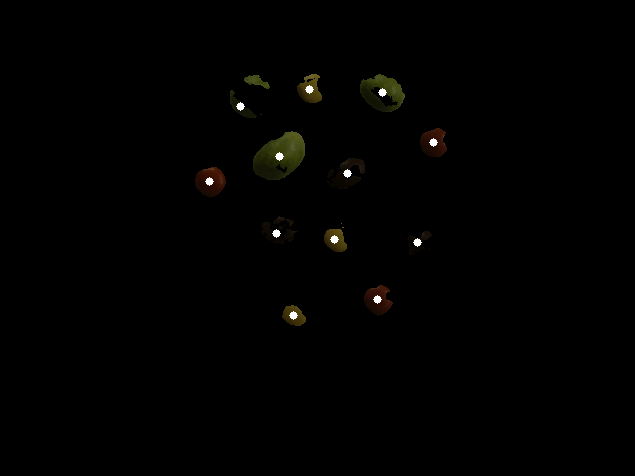




---------------------------------------------------------------------------------------



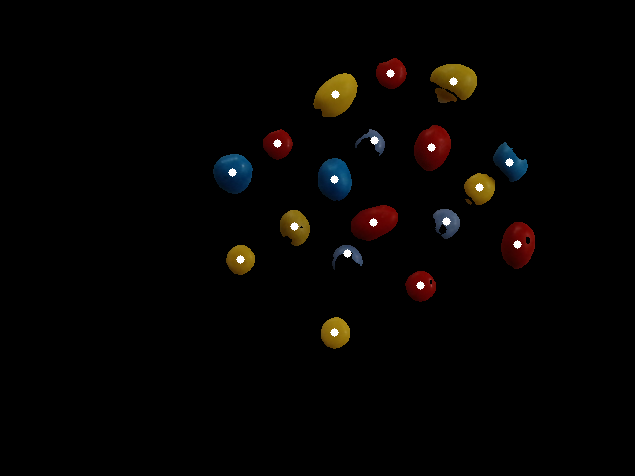




---------------------------------------------------------------------------------------



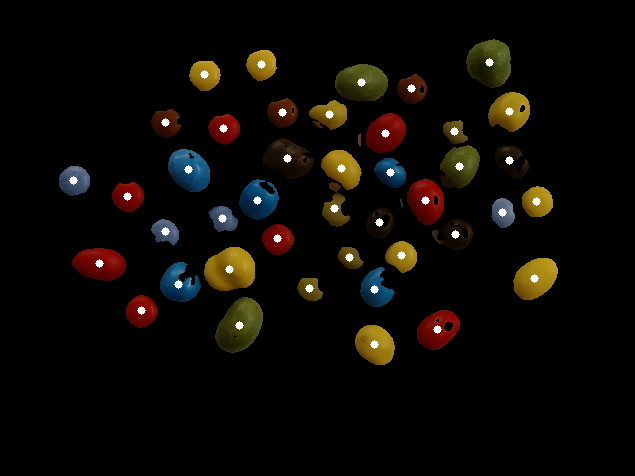

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
from matplotlib import colors
import pandas as pd
from google.colab.patches import cv2_imshow # for image display since cv2.imshow crashes the Colab
from skimage import io
from PIL import Image
import matplotlib.pylab as plt
import time


for image in data_images_array_mix:

  image_ori=undistort_image(image)
  #cv2_imshow(image_ori)
  #print("\n\n")

  image=cv2.bilateralFilter(image_ori, d=9, sigmaColor=75, sigmaSpace=75)
  #cv2_imshow(image)
  #print("\n\n")

  image_hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
  image_hsv[:, :, 2] = cv2.add(image_hsv[:, :, 2], 255)

  image_bgr = cv2.cvtColor(image_hsv, cv2.COLOR_HSV2BGR)
  image_gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)

  #cv2_imshow(image_gray)
  #print("\n\n")

  kernel_3 = np.ones((3, 3), np.uint8)
  edges = cv2.Canny(image_gray, 50, 200)
  edges = cv2.dilate(edges, kernel_3, iterations=1)
  #print("edges")
  #cv2_imshow(edges)

  object_mask_r = cv2.inRange(image_hsv, light_color_r, dark_color_r)
  object_mask_b = cv2.inRange(image_hsv, light_color_b, dark_color_b)
  object_mask_lb = cv2.inRange(image_hsv, light_color_lb, dark_color_lb)
  object_mask_lbrown = cv2.inRange(image_hsv, light_color_lbrown, dark_color_lbrown)
  object_mask_dbrown = cv2.inRange(image_hsv, light_color_dbrown, dark_color_dbrown)
  object_mask_yg = cv2.inRange(image_hsv, light_color_yg, dark_color_yg)
  object_mask_dg = cv2.inRange(image_hsv, light_color_dg, dark_color_dg)

  kernel_3 = np.ones((3, 3), np.uint8)

  object_mask_r_clean = cv2.medianBlur(object_mask_r, 3)
  object_mask_r_clean = cv2.erode(object_mask_r_clean, kernel_3, iterations=1)
  object_mask_r_clean = cv2.dilate(object_mask_r_clean, kernel_3, iterations=1)
  object_mask_b_clean = cv2.medianBlur(object_mask_b, 3)
  object_mask_b_clean = cv2.erode(object_mask_b_clean, kernel_3, iterations=1)
  object_mask_b_clean = cv2.dilate(object_mask_b_clean, kernel_3, iterations=1)
  object_mask_lb_clean = cv2.medianBlur(object_mask_lb, 3)
  object_mask_lb_clean = cv2.erode(object_mask_lb_clean, kernel_3, iterations=1)
  object_mask_lb_clean = cv2.dilate(object_mask_lb_clean, kernel_3, iterations=1)
  object_mask_lbrown_clean = cv2.medianBlur(object_mask_lbrown, 3)
  object_mask_lbrown_clean = cv2.erode(object_mask_lbrown_clean, kernel_3, iterations=1)
  object_mask_lbrown_clean = cv2.dilate(object_mask_lbrown_clean, kernel_3, iterations=1)
  object_mask_dbrown_clean = cv2.medianBlur(object_mask_dbrown, 3)
  object_mask_dbrown_clean = cv2.erode(object_mask_dbrown_clean, kernel_3, iterations=1)
  object_mask_dbrown_clean = cv2.dilate(object_mask_dbrown_clean, kernel_3, iterations=1)

  object_mask  = cv2.bitwise_or(object_mask_r, object_mask_b)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_lb)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_lbrown)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_dbrown)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_yg)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_dg)


  #cv2_imshow(object_mask)
  #print("image_gray_filtered")
  mask_inversed = cv2.bitwise_not(object_mask)
  object_mask = cv2.subtract(object_mask ,edges)
  object_mask = cv2.medianBlur(object_mask, 3)
  #cv2_imshow(object_mask)
  #print("\n\n")

  non_white_pixels = image_gray[image_gray <= 255]

  kernel_3 = np.ones((5, 5), np.uint8)

  object_mask_clean = object_mask

  contours,_=cv2.findContours(object_mask , cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

  image_ori_show= cv2.bitwise_and(image_ori, image_ori, mask=object_mask)

  # Consider only contours with area higher than 20
  for c in contours:
        if cv2.contourArea(c) < 200:
            continue

        M = cv2.moments(c)
        if M["m00"] != 0:
            cX = int(M["m10"] / M["m00"])
            cY = int(M["m01"] / M["m00"])
        else:
            cX, cY = 0, 0

        # Desenhar o centróide na imagem original
        cv2.circle(image_ori_show, (cX, cY), 4, (255, 255, 255), -1)

    # Exibir a imagem final com todos os centróides
  print("\n\n")
  print("---------------------------------------------------------------------------------------\n")
  cv2_imshow(image_ori_show)

##4-c)
The following code is similar to part (a) but displays the information on a table.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
from matplotlib import colors
import pandas as pd
from google.colab.patches import cv2_imshow # for image display since cv2.imshow crashes the Colab
from skimage import io
from PIL import Image
import matplotlib.pylab as plt
import time


image_index=0
results = []
for image in data_images_array_mix:
  blue_cnt=0
  blue_nut_cnt=0
  brown_cnt=0
  brown_nut_cnt=0
  green_cnt=0
  green_nut_cnt=0
  red_cnt=0
  red_nut_cnt=0
  yellow_cnt=0
  yellow_nut_cnt=0

  image_ori=undistort_image(image)

  image=cv2.bilateralFilter(image_ori, d=9, sigmaColor=75, sigmaSpace=75)

  image_hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
  image_hsv[:, :, 2] = cv2.add(image_hsv[:, :, 2], 255)

  image_bgr = cv2.cvtColor(image_hsv, cv2.COLOR_HSV2BGR)
  image_gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)

  kernel_3 = np.ones((3, 3), np.uint8)
  edges = cv2.Canny(image_gray, 50, 200)
  edges = cv2.dilate(edges, kernel_3, iterations=1)

  object_mask_r = cv2.inRange(image_hsv, light_color_r, dark_color_r)
  object_mask_b = cv2.inRange(image_hsv, light_color_b, dark_color_b)
  object_mask_lb = cv2.inRange(image_hsv, light_color_lb, dark_color_lb)
  object_mask_lbrown = cv2.inRange(image_hsv, light_color_lbrown, dark_color_lbrown)
  object_mask_dbrown = cv2.inRange(image_hsv, light_color_dbrown, dark_color_dbrown)
  object_mask_yg = cv2.inRange(image_hsv, light_color_yg, dark_color_yg)
  object_mask_dg = cv2.inRange(image_hsv, light_color_dg, dark_color_dg)

  kernel_3 = np.ones((3, 3), np.uint8)

  object_mask_r_clean = cv2.medianBlur(object_mask_r, 3)
  object_mask_r_clean = cv2.erode(object_mask_r_clean, kernel_3, iterations=1)
  object_mask_r_clean = cv2.dilate(object_mask_r_clean, kernel_3, iterations=1)
  object_mask_b_clean = cv2.medianBlur(object_mask_b, 3)
  object_mask_b_clean = cv2.erode(object_mask_b_clean, kernel_3, iterations=1)
  object_mask_b_clean = cv2.dilate(object_mask_b_clean, kernel_3, iterations=1)
  object_mask_lb_clean = cv2.medianBlur(object_mask_lb, 3)
  object_mask_lb_clean = cv2.erode(object_mask_lb_clean, kernel_3, iterations=1)
  object_mask_lb_clean = cv2.dilate(object_mask_lb_clean, kernel_3, iterations=1)
  object_mask_lbrown_clean = cv2.medianBlur(object_mask_lbrown, 3)
  object_mask_lbrown_clean = cv2.erode(object_mask_lbrown_clean, kernel_3, iterations=1)
  object_mask_lbrown_clean = cv2.dilate(object_mask_lbrown_clean, kernel_3, iterations=1)
  object_mask_dbrown_clean = cv2.medianBlur(object_mask_dbrown, 3)
  object_mask_dbrown_clean = cv2.erode(object_mask_dbrown_clean, kernel_3, iterations=1)
  object_mask_dbrown_clean = cv2.dilate(object_mask_dbrown_clean, kernel_3, iterations=1)

  object_mask  = cv2.bitwise_or(object_mask_r, object_mask_b)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_lb)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_lbrown)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_dbrown)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_yg)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_dg)

  mask_inversed = cv2.bitwise_not(object_mask)
  object_mask = cv2.subtract(object_mask ,edges)
  object_mask = cv2.medianBlur(object_mask, 3)

  non_white_pixels = image_gray[image_gray <= 255]

  kernel_3 = np.ones((5, 5), np.uint8)

  object_mask_clean = object_mask

  contours,_=cv2.findContours(object_mask , cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

  true_contours = 0;

  # Consider only contours with area higher than 20
  for c in contours:
    if (cv2.contourArea(c) < 200):
      continue
    mask = np.zeros(image_hsv.shape[:2], dtype=np.uint8)
    cv2.drawContours(mask, [c], -1, 255, thickness=cv2.FILLED)

    h_channel = image_hsv[:, :, 0][mask == 255]  # Extract hue channel where mask is white
    s_channel = image_hsv[:, :, 1][mask == 255]  # Extract saturation channel where mask is white

    median_h = np.median(h_channel)
    median_s = np.median(s_channel)

    median_hsv = (median_h, median_s)

    color_class = classify_color(median_hsv, cv2.contourArea(c))


  images_desc_table = ["Green_Brown", "All_Mix", "Blue_Yellow_Red"]
  results.append({
       "Image": f"{images_desc_table[image_index]}",
      "Blue": blue_cnt,
       "Blue Nut": blue_nut_cnt,
       "Brown": brown_cnt,
      "Brown Nut": brown_nut_cnt,
        "Green": green_cnt,
       "Green Nut": green_nut_cnt,
       "Red": red_cnt,
       "Red Nut": red_nut_cnt,
       "Yellow": yellow_cnt,
      "Yellow Nut": yellow_nut_cnt
   })
  image_index += 1

# Convert results to a pandas DataFrame and display as a table
df_results = pd.DataFrame(results)

# Transpose the DataFrame to display it vertically
df_results_transposed = df_results.T

# Reset the index names to remove column headers
df_results_transposed.columns = df_results_transposed.iloc[0]
df_results_transposed = df_results_transposed[1:]

# Print the transposed DataFrame without the numbers
print(df_results_transposed)

# Optionally, you can display the table in a Jupyter environment
# df_results_transposed.to_html()

Image      Green_Brown All_Mix Blue_Yellow_Red
Blue                 0       3               4
Blue Nut             0       3               5
Brown                3       0               3
Brown Nut            3       0               4
Green                3       0               4
Green Nut            3       0               4
Red                  0       3               4
Red Nut              0       3               4
Yellow               0       3               4
Yellow Nut           0       3               6


##4-d)

This method has some limitations, including the inability to recognize M&Ms of different colors, as the mask is constructed based on specific colors in the provided images. Additionally, due to errors in mask creation, the area of an M&M with a nut may appear smaller than that of one without a nut, potentially leading to inaccuracies in classification.

##4-e)

-Optimize the imaging setup by ensuring consistent and uniform lighting from above to minimize shadows, which can affect color detection and contour accuracy.

-Separating the M&Ms at the moment of capture improves edge detection.

-Calibration of cameras and sensors is essential to maintain precision in color differentiation and area recognition.

-To reduce photometric effects use diffusers (e.g., softboxes or translucent materials) to soften the light, reducing strong reflections in the M&M by spreading the light evenly across the surface.

# 5

##5-a)

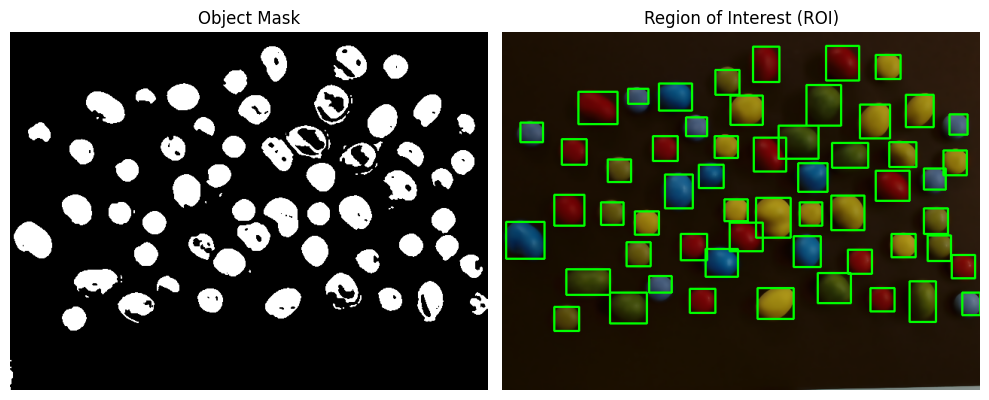

Number of M&Ms: 56
Number of Red: 7
Number of Red Nuts: 7
Number of Blue: 7
Number of Blue Nuts: 7
Number of Green: 7
Number of Green Nuts: 7
Number of Yellow: 7
Number of Yellow Nuts: 7


In [ ]:

blue_cnt=0
blue_nut_cnt=0
green_cnt=0
green_nut_cnt=0
red_cnt=0
red_nut_cnt=0
yellow_cnt=0
yellow_nut_cnt=0

def classify_color_brown(median_hsv, area):
    median_h, median_s = median_hsv
    global blue_cnt, blue_nut_cnt, green_cnt, green_nut_cnt, red_cnt, red_nut_cnt, yellow_cnt, yellow_nut_cnt

    if (median_h >= 101 and median_h <= 107 and median_s > 147 and median_s < 250):
        blue_nut_cnt += 1
        return "Blue Nut"
    elif (median_h >= 106 and median_h <= 110 and median_s > 61 and median_s < 114):
        blue_cnt += 1
        return "Blue"
    elif (median_h >= 0 and median_h <= 2 and median_s > 217 and median_s < 254):
        if(area > 895):
            red_nut_cnt += 1
            return "Red Nut"
        else:
            red_cnt += 1
        return "Red"
    elif (median_h >= 21 and median_h <= 24 and median_s >= 215  and median_s <= 235):
        if(area > 725):
            yellow_nut_cnt += 1
            return "Yellow Nut"
        else:
            yellow_cnt += 1
        return "Yellow"
    elif (median_h >= 24 and median_h < 30 and median_s >= 203  and median_s <= 227):
        green_cnt += 1
        return "Green"
    elif (median_h >= 30 and median_h <= 37 and median_s >= 203  and median_s <= 227):
        green_nut_cnt += 1
        return "Green Nut"
    else:
        print("UK")
        print(median_h)
        print(median_s)
        print("\n")
        return "Unknown"


#RED
light_color_r = (0, 217, 0)
dark_color_r = (2,254, 255)

#BLUE
light_color_b = (101, 147, 0)
dark_color_b = (107,250, 255)

#LBLUE
light_color_lb = (106, 61, 0)
dark_color_lb = (110,114, 255)

#YELLOW and LGREEN
light_color_yg = (19, 191, 0)
dark_color_yg = (24,253, 255)

#DGREEN
light_color_dg = (25, 133, 0)
dark_color_dg = (35,231, 255)




for image in data_images_array_brown:
  dark_blue_cnt=0
  light_blue_cnt=0
  red_cnt=0
  yellow_cnt=0
  light_green_cnt=0
  dark_green_cnt=0
  image_ori=undistort_image(image)

  #cv2_imshow(image_ori)
  #print("\n\n")

  image=cv2.bilateralFilter(image_ori, d=9, sigmaColor=75, sigmaSpace=75)
  #cv2_imshow(image)
  #print("\n\n")

  image_hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
  image_hsv[:, :, 2] = cv2.add(image_hsv[:, :, 2], 255)

  image_bgr = cv2.cvtColor(image_hsv, cv2.COLOR_HSV2BGR)
  image_gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)
  #image_gray = cv2.add(image_gray, np.full(image_gray.shape, 10, dtype=np.uint8))
  #cv2_imshow(image_gray)
  #print("\n\n")

  kernel_3 = np.ones((3, 3), np.uint8)
  edges = cv2.Canny(image_gray, 50, 200)
  edges = cv2.dilate(edges, kernel_3, iterations=1)
  #print("edges")
  #cv2_imshow(edges)

  object_mask_r = cv2.inRange(image_hsv, light_color_r, dark_color_r)
  object_mask_b = cv2.inRange(image_hsv, light_color_b, dark_color_b)
  object_mask_lb = cv2.inRange(image_hsv, light_color_lb, dark_color_lb)
  object_mask_yg = cv2.inRange(image_hsv, light_color_yg, dark_color_yg)
  object_mask_dg = cv2.inRange(image_hsv, light_color_dg, dark_color_dg)

  kernel_3 = np.ones((3, 3), np.uint8)

  object_mask_r_clean = cv2.medianBlur(object_mask_r, 3)
  object_mask_r_clean = cv2.erode(object_mask_r_clean, kernel_3, iterations=1)
  object_mask_r_clean = cv2.dilate(object_mask_r_clean, kernel_3, iterations=1)
  object_mask_b_clean = cv2.medianBlur(object_mask_b, 3)
  object_mask_b_clean = cv2.erode(object_mask_b_clean, kernel_3, iterations=1)
  object_mask_b_clean = cv2.dilate(object_mask_b_clean, kernel_3, iterations=1)
  object_mask_lb_clean = cv2.medianBlur(object_mask_lb, 3)
  object_mask_lb_clean = cv2.erode(object_mask_lb_clean, kernel_3, iterations=1)
  object_mask_lb_clean = cv2.dilate(object_mask_lb_clean, kernel_3, iterations=1)
  object_mask  = cv2.bitwise_or(object_mask_r, object_mask_b)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_lb)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_yg)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_dg)


  #cv2_imshow(object_mask)
  #print("image_gray_filtered")
  mask_inversed = cv2.bitwise_not(object_mask)
  object_mask = cv2.subtract(object_mask ,edges)
  object_mask = cv2.medianBlur(object_mask, 3)
  #cv2_imshow(object_mask)
  #print("\n\n")

  non_white_pixels = image_gray[image_gray <= 255]

  kernel_3 = np.ones((5, 5), np.uint8)

  object_mask_clean = object_mask

  contours,_=cv2.findContours(object_mask , cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

  true_contours = 0;

  # Consider only contours with area higher than 20
  for c in contours:
    if (cv2.contourArea(c) < 200):
      continue
    mask = np.zeros(image_hsv.shape[:2], dtype=np.uint8)
    cv2.drawContours(mask, [c], -1, 255, thickness=cv2.FILLED)

    h_channel = image_hsv[:, :, 0][mask == 255]  # Extract hue channel where mask is white
    s_channel = image_hsv[:, :, 1][mask == 255]  # Extract saturation channel where mask is white

    # Compute the median for each channel
    median_h = np.median(h_channel)
    median_s = np.median(s_channel)

    # Combine the medians into a tuple
    median_hsv = (median_h, median_s)

    # Classify the color based on the median HSV values
    color_class = classify_color_brown(median_hsv, cv2.contourArea(c))

    #print("Color Class: " + color_class)
    #cv2_imshow(mask)
    #print("\n\n")
    x,y,w,h = cv2.boundingRect(c)
    ROI=cv2.rectangle(image,(x,y),(x+w,y+h),(0,255,0),2)
    true_contours += 1

  #show image with centroid
  fig, axes = plt.subplots(1, 2, figsize=(10, 5))  # 1 row, 2 columns

  # Display the first image
  axes[0].imshow(object_mask_clean, cmap='gray')
  axes[0].set_title("Object Mask")
  axes[0].axis('off')  # Turn off axis

  # Display the second image
  ROI = cv2.cvtColor(ROI, cv2.COLOR_BGR2RGB)
  axes[1].imshow(ROI)
  axes[1].set_title("Region of Interest (ROI)")
  axes[1].axis('off')  # Turn off axis

  # Show the plot
  #plt.suptitle("White Isolated " + str(image_desc) + " Mask and ROI, " + str(true_contours) + " M&M's identified", fontsize=16)
  plt.tight_layout()
  plt.show()
  print("Number of M&Ms: " + str(true_contours))
  print("Number of Red: " + str(red_cnt))
  print("Number of Red Nuts: " + str(red_nut_cnt))
  print("Number of Blue: " + str(blue_cnt))
  print("Number of Blue Nuts: " + str(blue_nut_cnt))
  print("Number of Green: " + str(green_cnt))
  print("Number of Green Nuts: " + str(green_nut_cnt))
  print("Number of Yellow: " + str(yellow_cnt))
  print("Number of Yellow Nuts: " + str(yellow_nut_cnt))


##5-b)

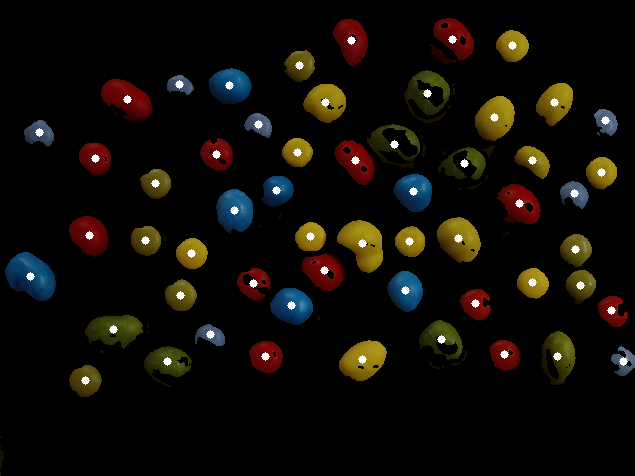

In [ ]:

for image in data_images_array_brown:
  image=cv2.bilateralFilter(image_ori, d=9, sigmaColor=75, sigmaSpace=75)
  #cv2_imshow(image)
  #print("\n\n")

  image_hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
  image_hsv[:, :, 2] = cv2.add(image_hsv[:, :, 2], 255)

  image_bgr = cv2.cvtColor(image_hsv, cv2.COLOR_HSV2BGR)
  image_gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)
  #image_gray = cv2.add(image_gray, np.full(image_gray.shape, 10, dtype=np.uint8))
  #cv2_imshow(image_gray)
  #print("\n\n")

  kernel_3 = np.ones((3, 3), np.uint8)
  edges = cv2.Canny(image_gray, 50, 200)
  edges = cv2.dilate(edges, kernel_3, iterations=1)
  #print("edges")
  #cv2_imshow(edges)

  object_mask_r = cv2.inRange(image_hsv, light_color_r, dark_color_r)
  object_mask_b = cv2.inRange(image_hsv, light_color_b, dark_color_b)
  object_mask_lb = cv2.inRange(image_hsv, light_color_lb, dark_color_lb)
  object_mask_yg = cv2.inRange(image_hsv, light_color_yg, dark_color_yg)
  object_mask_dg = cv2.inRange(image_hsv, light_color_dg, dark_color_dg)

  kernel_3 = np.ones((3, 3), np.uint8)

  object_mask_r_clean = cv2.medianBlur(object_mask_r, 3)
  object_mask_r_clean = cv2.erode(object_mask_r_clean, kernel_3, iterations=1)
  object_mask_r_clean = cv2.dilate(object_mask_r_clean, kernel_3, iterations=1)
  object_mask_b_clean = cv2.medianBlur(object_mask_b, 3)
  object_mask_b_clean = cv2.erode(object_mask_b_clean, kernel_3, iterations=1)
  object_mask_b_clean = cv2.dilate(object_mask_b_clean, kernel_3, iterations=1)
  object_mask_lb_clean = cv2.medianBlur(object_mask_lb, 3)
  object_mask_lb_clean = cv2.erode(object_mask_lb_clean, kernel_3, iterations=1)
  object_mask_lb_clean = cv2.dilate(object_mask_lb_clean, kernel_3, iterations=1)
  object_mask  = cv2.bitwise_or(object_mask_r, object_mask_b)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_lb)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_yg)
  object_mask  = cv2.bitwise_or(object_mask, object_mask_dg)


  #cv2_imshow(object_mask)
  #print("image_gray_filtered")
  mask_inversed = cv2.bitwise_not(object_mask)
  object_mask = cv2.subtract(object_mask ,edges)
  object_mask = cv2.medianBlur(object_mask, 3)
  #cv2_imshow(object_mask)
  #print("\n\n")

  non_white_pixels = image_gray[image_gray <= 255]

  kernel_3 = np.ones((5, 5), np.uint8)

  object_mask_clean = object_mask

  contours,_=cv2.findContours(object_mask , cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

  image_ori_show= cv2.bitwise_and(image_ori, image_ori, mask=object_mask)
  # Consider only contours with area higher than 20
  for c in contours:
    if (cv2.contourArea(c) < 200):
      continue

    M = cv2.moments(c)
    if M["m00"] != 0:
            cX = int(M["m10"] / M["m00"])
            cY = int(M["m01"] / M["m00"])
    else:
            cX, cY = 0, 0

    cv2.circle(image_ori_show, (cX, cY), 4, (255, 255, 255), -1)

  cv2_imshow(image_ori_show)


##5-c)

In [ ]:

for image in data_images_array_brown:
  blue_cnt=0
  blue_nut_cnt=0
  green_cnt=0
  green_nut_cnt=0
  red_cnt=0
  red_nut_cnt=0
  yellow_cnt=0
  yellow_nut_cnt=0


  image_ori=undistort_image(image)
  image=cv2.bilateralFilter(image_ori, d=9, sigmaColor=75, sigmaSpace=75)

  results = []
  # Consider only contours with area higher than 20
  for c in contours:
    if (cv2.contourArea(c) < 200):
      continue
    mask = np.zeros(image_hsv.shape[:2], dtype=np.uint8)
    cv2.drawContours(mask, [c], -1, 255, thickness=cv2.FILLED)

    h_channel = image_hsv[:, :, 0][mask == 255]  # Extract hue channel where mask is white
    s_channel = image_hsv[:, :, 1][mask == 255]  # Extract saturation channel where mask is white

    # Compute the median for each channel
    median_h = np.median(h_channel)
    median_s = np.median(s_channel)

    # Combine the medians into a tuple
    median_hsv = (median_h, median_s)

    # Classify the color based on the median HSV values
    color_class = classify_color_brown(median_hsv, cv2.contourArea(c))


  results.append({
       "Image": "All_mix_brown",
      "Blue": blue_cnt,
       "Blue Nut": blue_nut_cnt,
        "Green": green_cnt,
       "Green Nut": green_nut_cnt,
       "Red": red_cnt,
       "Red Nut": red_nut_cnt,
       "Yellow": yellow_cnt,
      "Yellow Nut": yellow_nut_cnt
   })
  image_index += 1

# Convert results to a pandas DataFrame and display as a table
df_results = pd.DataFrame(results)

# Transpose the DataFrame to display it vertically
df_results_transposed = df_results.T

# Reset the index names to remove column headers
df_results_transposed.columns = df_results_transposed.iloc[0]
df_results_transposed = df_results_transposed[1:]

# Print the transposed DataFrame without the numbers
print(df_results_transposed)


Image      All_mix_brown
Blue                   7
Blue Nut               7
Green                  7
Green Nut              7
Red                    7
Red Nut                7
Yellow                 7
Yellow Nut             7
